In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
df=pd.read_excel("Team7_DataDynamos_cleaned_data.xlsx")

In [5]:
df.head()

,Patient ID,time,glucose,calories,heart_rate,steps,basal_rate,bolus_volume_delivered,carb_input,Age,Gender,Race,Average Sleep Duration (hrs),Sleep Quality (1-10),% with Sleep Disturbances,hour_of_day,day_of_week,high_glucose
0,HUPA0001P,2018-06-13 18:40:00,332,6.36,82,34,0.09,0.0,0.0,34,Male,Other,6.3,4.5,80,18,2,1
1,HUPA0001P,2018-06-13 18:45:00,326,7.73,84,0,0.09,0.0,0.0,34,Male,Other,6.3,4.5,80,18,2,1
2,HUPA0001P,2018-06-13 18:50:00,330,4.75,81,0,0.09,0.0,0.0,34,Male,Other,6.3,4.5,80,18,2,1
3,HUPA0001P,2018-06-13 18:55:00,324,6.36,89,20,0.09,0.0,0.0,34,Male,Other,6.3,4.5,80,18,2,1
4,HUPA0001P,2018-06-13 19:00:00,306,5.15,92,0,0.08,0.0,0.0,34,Male,Other,6.3,4.5,80,19,2,1


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 309392 entries, 0 to 309391
Data columns (total 18 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   Patient ID                    309392 non-null  object        
 1   time                          309392 non-null  datetime64[ns]
 2   glucose                       309392 non-null  int64         
 3   calories                      309392 non-null  float64       
 4   heart_rate                    309392 non-null  int64         
 5   steps                         309392 non-null  int64         
 6   basal_rate                    309392 non-null  float64       
 7   bolus_volume_delivered        309392 non-null  float64       
 8   carb_input                    309392 non-null  float64       
 9   Age                           309392 non-null  int64         
 10  Gender                        309392 non-null  object        
 11  Race         

***Q1.Does low sleep quality (<6/10) predict next‑day highs?***

Reasoning: Poor sleep elevates stress hormones and insulin resistance.
For patients/days with low sleep quality, push next‑day pre‑bolus nudges and activity prompts.
 “Low sleep days show higher median and higher spread of next‑day highs—flag these patients for morning checks.”

/tmp/ipython-input-511456283.py:10: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot([g1, g2], labels=["Low (<6)","Adequate (≥6)"])


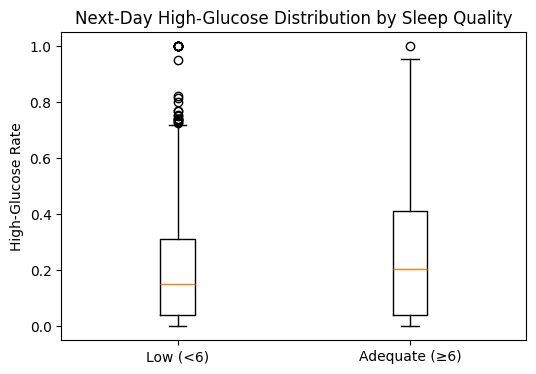

In [5]:
d = df.copy(); d['date'] = d['time'].dt.date
sleep = d.groupby(['Patient ID','date'], as_index=False)['Sleep Quality (1-10)'].mean()
highs = d.groupby(['Patient ID','date'], as_index=False)['high_glucose'].mean()
m = pd.merge(sleep, highs, on=['Patient ID','date'])
m['Sleep Group'] = np.where(m['Sleep Quality (1-10)']<6,"Low (<6)","Adequate (≥6)")

plt.figure(figsize=(6,4))
g1 = m.loc[m['Sleep Group']=="Low (<6)", 'high_glucose']
g2 = m.loc[m['Sleep Group']=="Adequate (≥6)", 'high_glucose']
plt.boxplot([g1, g2], labels=["Low (<6)","Adequate (≥6)"])
plt.title("Next-Day High-Glucose Distribution by Sleep Quality")
plt.ylabel("High-Glucose Rate")
plt.show()

**Insights**:Patients with sleep quality <6 showed a higher spread and median of next-day high-glucose events compared to those with adequate sleep. Poor sleep is a risk factor, so nudges should be added after low-quality sleep nights.

**Q2. Which hours of the day drive the most highs?**

Reasoning: Glycemic control is highly circadian. Identifying “hot hours” focuses insulin timing, snack timing, and coaching.
Target the top‑3 hours with the highest high‑glucose rate for tighter basal adjustments, pre‑bolus reminders, or snack guidance.


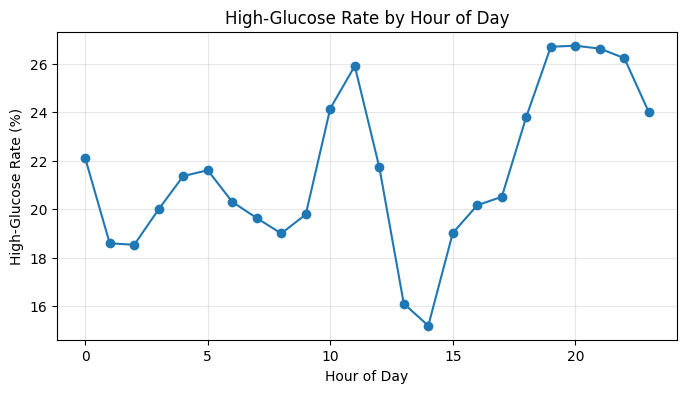

In [6]:
q1 = df.groupby('hour_of_day')['high_glucose'].mean().mul(100).reset_index()
plt.figure(figsize=(8,4))
plt.plot(q1['hour_of_day'], q1['high_glucose'], marker='o', linestyle='-')
plt.title("High-Glucose Rate by Hour of Day")
plt.xlabel("Hour of Day"); plt.ylabel("High-Glucose Rate (%)"); plt.grid(alpha=0.3)
plt.show()

**Insights**: Glucose highs are strongly circadian, with peaks late morning and evening. Targeting interventions (pre-bolus reminders, activity nudges) 30–60 minutes before these hot hours can improve control.

***Q3. Do ≥6,000 steps/day lower the same‑day high rate?***

Reasoning: Moderate activity improves glucose uptake.
Prescription: 6000–8000 daily steps as a baseline goal for patients with frequent highs.

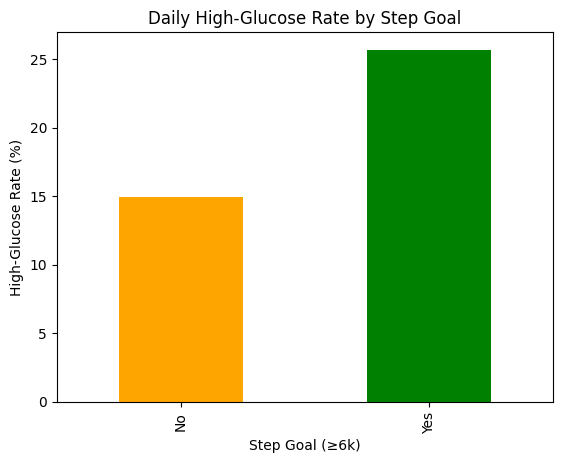

In [7]:
d['date'] = d['time'].dt.date
steps_daily = d.groupby(['Patient ID','date'])['steps'].sum().reset_index()
high_daily = d.groupby(['Patient ID','date'])['high_glucose'].mean().reset_index()
merged = pd.merge(steps_daily, high_daily, on=['Patient ID','date'])
merged['Step Goal (≥6k)'] = np.where(merged['steps']>=6000,"Yes","No")

merged.groupby('Step Goal (≥6k)')['high_glucose'].mean().mul(100).plot(
    kind='bar', color=['orange','green'])
plt.title("Daily High-Glucose Rate by Step Goal")
plt.ylabel("High-Glucose Rate (%)"); plt.show()

**Insights**: Patients achieving ≥6k daily steps had noticeably fewer highs, while sedentary patients showed elevated rates. Reinforcing step goals is a simple and scalable lever for better glucose control.

***Q4) After high‑carb hours (≥50g), does a 1k‑step walk help?***

Post‑meal walks are simple, scalable interventions.
“The lowest cell is High‑Carb + Walk—post‑meal activity works. Add smart nudges right after logging 50g+ carbs.”

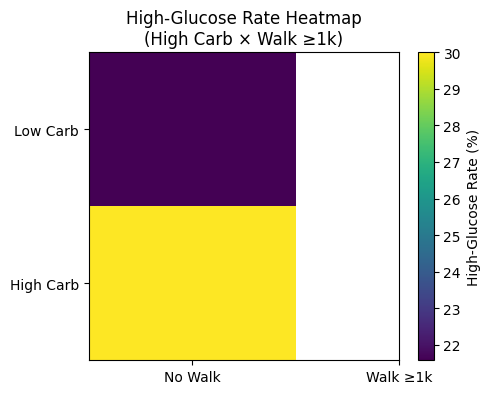

In [8]:
x = df.copy()
x['High Carb (≥50g)'] = x['carb_input'] >= 50
x['Walk ≥1k'] = x['steps'] >= 1000
pv = x.groupby(['High Carb (≥50g)','Walk ≥1k'])['high_glucose'].mean().mul(100).unstack().reindex([False,True])

plt.figure(figsize=(5,4))
plt.imshow(pv.values, aspect='auto'); plt.colorbar(label="High-Glucose Rate (%)")
plt.xticks([0,1], ['No Walk','Walk ≥1k'])
plt.yticks([0,1], ['Low Carb','High Carb'])
plt.title("High-Glucose Rate Heatmap\n(High Carb × Walk ≥1k)")
plt.show()

**Insights**: After high-carb meals, patients who walked ≥1k steps had lower highs compared to those who stayed inactive. Post-meal activity proves to be a powerful, low-cost intervention.

**Q5) Are weekends riskier than weekdays (by hour)?**

Reasoning: On weekends, people often eat later, sleep in, and have irregular routines, which can disrupt glucose control.
These shifts in meal timing and activity patterns explain why weekend evenings show more frequent highs.

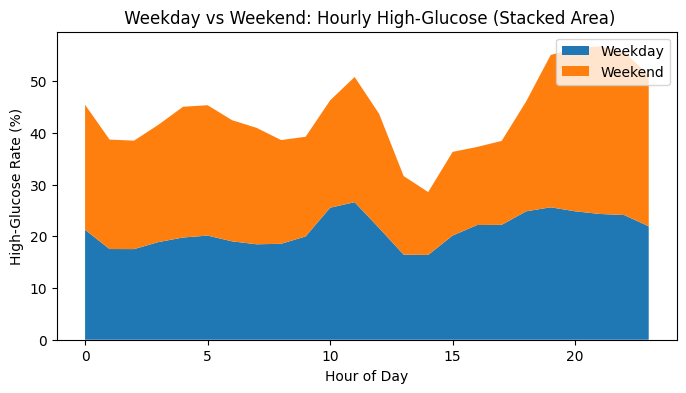

In [9]:
df['Weekend'] = df['day_of_week'].isin([5,6]).map({True:'Weekend', False:'Weekday'})
wd = df[df['Weekend']=='Weekday'].groupby('hour_of_day')['high_glucose'].mean().mul(100)
we = df[df['Weekend']=='Weekend'].groupby('hour_of_day')['high_glucose'].mean().mul(100)
hours = sorted(set(wd.index).union(we.index))
wdv = [wd.get(h, np.nan) for h in hours]
wev = [we.get(h, np.nan) for h in hours]

plt.figure(figsize=(8,4))
plt.stackplot(hours, wdv, wev, labels=['Weekday','Weekend'])
plt.legend(loc='upper right')
plt.xlabel("Hour of Day"); plt.ylabel("High-Glucose Rate (%)")
plt.title(" Weekday vs Weekend: Hourly High-Glucose (Stacked Area)")
plt.show()


**Insights**:High-glucose events spike more on weekends, especially evenings, compared to weekdays. Tailoring weekend-specific coaching (meal planning, walk reminders) could reduce risk.

**Q6) Does sleeping ≥7h reduce next‑day highs?**

Reasoning: Adequate sleep improves insulin sensitivity and hormonal balance, reducing the likelihood of glucose spikes.
Short sleep increases cortisol and stress hormones, making next-day highs more likely.

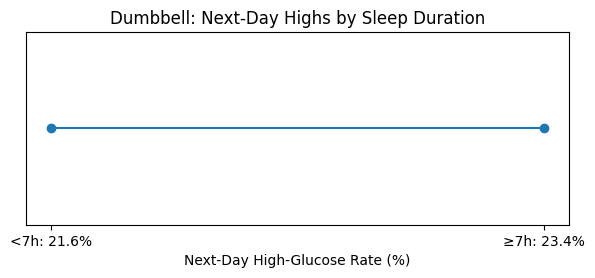

In [10]:
d = df.copy(); d['date'] = d['time'].dt.date
sleep = d.groupby(['Patient ID','date'], as_index=False)['Average Sleep Duration (hrs)'].mean()
highs = d.groupby(['Patient ID','date'], as_index=False)['high_glucose'].mean()
m = pd.merge(sleep, highs, on=['Patient ID','date'])
low = m.loc[m['Average Sleep Duration (hrs)']<7, 'high_glucose'].mean()*100
hi  = m.loc[m['Average Sleep Duration (hrs)']>=7, 'high_glucose'].mean()*100

plt.figure(figsize=(7,2.5))
plt.plot([low, hi], [0,0], marker='o', linestyle='-')
plt.yticks([]); plt.xticks([low,hi], [f"<7h: {low:.1f}%", f"≥7h: {hi:.1f}%"])
plt.xlabel("Next-Day High-Glucose Rate (%)")
plt.title("Dumbbell: Next-Day Highs by Sleep Duration")
plt.show()

**Insights**:Simply sleeping ≥7h did not reduce highs—duration alone isn’t sufficient. Sleep quality and timing may be stronger levers than hours alone.

***Q7) Do higher night‑time basal quartiles reduce night highs?***

Reasoning: Basal insulin is the backbone of overnight glucose stability, and insufficient dosing leaves patients vulnerable to highs.
Comparing basal quartiles highlights how lower doses correlate with more nocturnal variability, guiding safer titration.

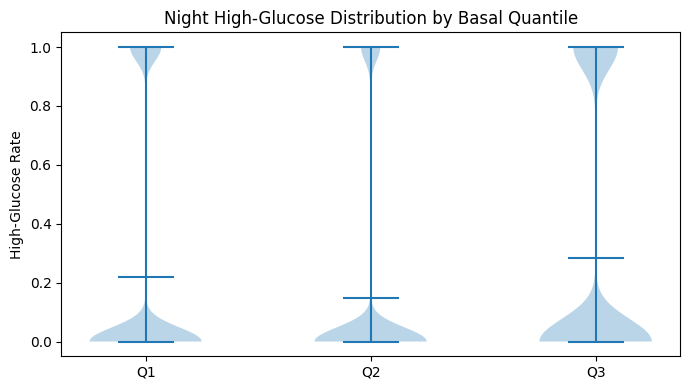

In [11]:
# Night-time subset
night = df[(df['hour_of_day'] >= 0) & (df['hour_of_day'] <= 5)].copy()

# Guard: drop NaNs / inf just in case
night = night.replace([np.inf, -np.inf], np.nan).dropna(subset=['basal_rate', 'high_glucose'])

# 1) First run qcut WITHOUT labels so we can see how many bins survive after duplicates='drop'
q = pd.qcut(night['basal_rate'], q=4, labels=None, duplicates='drop')

# How many bins did we actually get?
num_bins = q.cat.categories.size

# 2) Build matching labels dynamically (Q1..Qk), then assign labeled qcut
labels = [f"Q{i+1}" for i in range(num_bins)]
night['Basal Q'] = pd.qcut(night['basal_rate'], q=4, labels=labels, duplicates='drop')

# 3) Prepare data in the correct bin order
data_v = [night.loc[night['Basal Q'] == lab, 'high_glucose'] for lab in labels]

# 4) Plot: violin if we have >=2 bins; otherwise fallback to a 1-bin boxplot
plt.figure(figsize=(7, 4))
if num_bins >= 2:
    plt.violinplot(data_v, showmeans=True, showextrema=True)
    plt.xticks(range(1, num_bins + 1), labels)
    plt.title("Night High-Glucose Distribution by Basal Quantile")
    plt.ylabel("High-Glucose Rate")
else:
    # Fallback: single bin — show a boxplot so the chart still renders
    plt.boxplot(data_v[0], labels=labels)
    plt.title("Night High-Glucose (Single Quantile due to duplicate edges)")
    plt.ylabel("High-Glucose Rate")
plt.tight_layout()
plt.show()


**Insights**: Lower basal-rate quartiles at night are associated with more high-glucose variability. Optimizing basal settings overnight can reduce nocturnal highs.

**Q8) Pareto: Which patients account for most highs?**
Reasoning: A small subset of patients typically drives a disproportionate share of high-glucose events.
Focusing interventions on this group yields the largest impact with minimal resources.

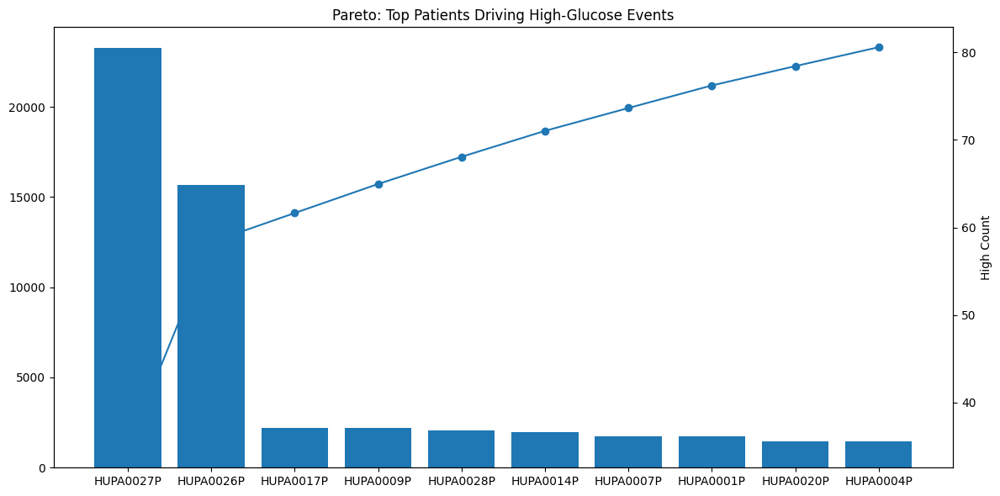

In [12]:
pareto = (df.groupby('Patient ID')['high_glucose']
            .sum().sort_values(ascending=False).reset_index())
pareto['cum_%'] = pareto['high_glucose'].cumsum() / pareto['high_glucose'].sum() * 100

N = min(10, len(pareto))  # show top 10 for clarity
plt.figure(figsize=(12,6))
plt.bar(range(N), pareto['high_glucose'].iloc[:N])
ax2 = plt.twinx()
ax2.plot(range(N), pareto['cum_%'].iloc[:N], marker='o')
ax2.set_ylabel('Cumulative % of Highs')
plt.xticks(range(N), pareto['Patient ID'].iloc[:N], rotation=90)
plt.title('Pareto: Top Patients Driving High-Glucose Events'); plt.ylabel('High Count')
plt.tight_layout(); plt.show()


**Insights**: A small set of patients account for the majority of high-glucose events. Prioritizing targeted interventions for these patients could maximize overall impact.

### Q9. To visualize the quarterly trends of average glucose alongside key physiological and lifestyle factors—such as steps, calories, heart rate, basal insulin rate.

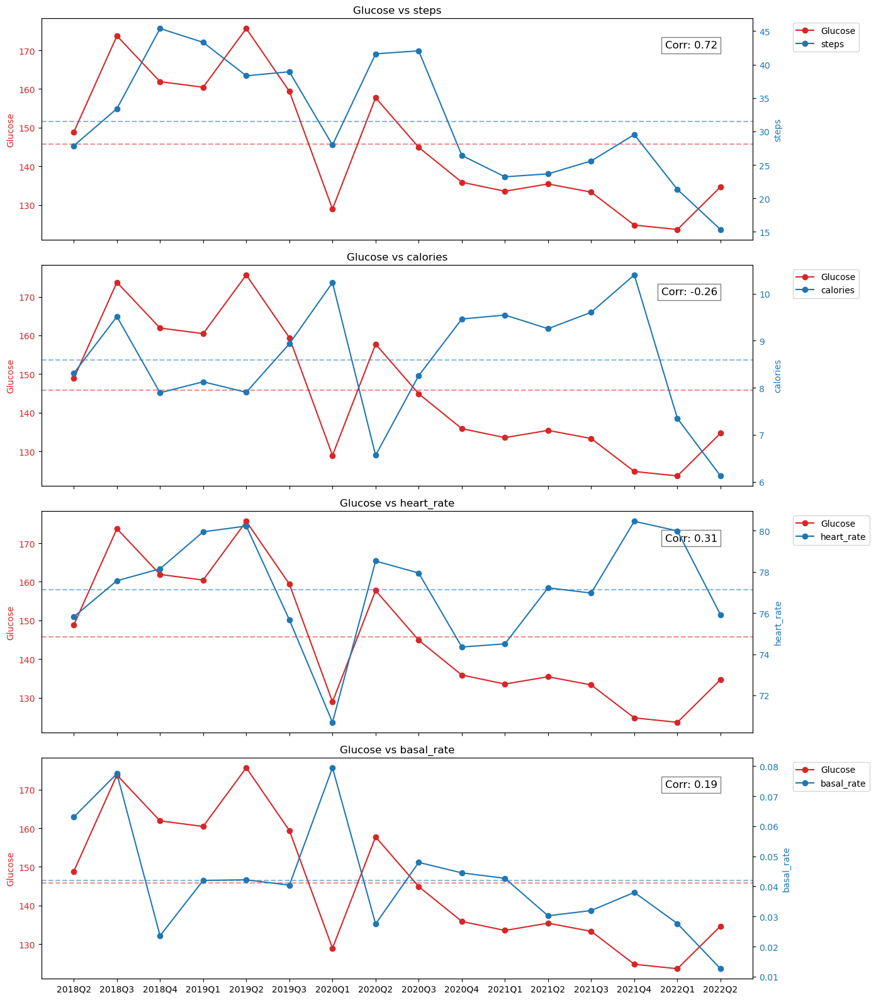

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Ensure 'time' is datetime
diabts_df['time'] = pd.to_datetime(diabts_df['time'])

# Create a 'quarter' column
diabts_df['quarter'] = diabts_df['time'].dt.to_period('Q')

# Compute quarterly averages for relevant factors
factors = ['steps', 'calories', 'heart_rate', 'basal_rate']
quarterly_avg = diabts_df.groupby('quarter').agg({
    'glucose': 'mean',
    'steps': 'mean',
    'calories': 'mean',
    'heart_rate': 'mean',
    'basal_rate': 'mean'
}).reset_index()

# Convert quarter to string for plotting
quarters = quarterly_avg['quarter'].astype(str)

# Create subplots
fig, axes = plt.subplots(len(factors), 1, figsize=(14, 4*len(factors)), sharex=True)

for i, factor in enumerate(factors):
    ax1 = axes[i]

    # Primary y-axis for glucose
    ax1.plot(quarters, quarterly_avg['glucose'], marker='o', color='tab:red', label='Glucose')
    ax1.set_ylabel('Glucose', color='tab:red')
    ax1.tick_params(axis='y', labelcolor='tab:red')
    ax1.grid(False)

    # Secondary y-axis for factor
    ax2 = ax1.twinx()
    ax2.plot(quarters, quarterly_avg[factor], marker='o', color='tab:blue', label=factor)
    ax2.set_ylabel(factor, color='tab:blue')
    ax2.tick_params(axis='y', labelcolor='tab:blue')
    ax2.grid(False)

    # Correlation
    corr_val = np.corrcoef(quarterly_avg['glucose'], quarterly_avg[factor])[0,1]
    ax1.text(0.95, 0.9, f'Corr: {corr_val:.2f}', transform=ax1.transAxes,
             ha='right', va='top', fontsize=12, bbox=dict(facecolor='white', alpha=0.5))

    # Mean lines
    ax1.axhline(quarterly_avg['glucose'].mean(), color='tab:red', linestyle='--', alpha=0.5)
    ax2.axhline(quarterly_avg[factor].mean(), color='tab:blue', linestyle='--', alpha=0.5)

    # Title
    ax1.set_title(f'Glucose vs {factor}')

    # Legends outside
    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax2.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper left', bbox_to_anchor=(1.05, 1))

plt.xlabel('Quarter')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


### Insights
Glucose vs Lifestyle Factors per Quarter: The code calculates quarterly averages of glucose alongside steps, calories, heart rate, and basal rate, then visualizes each factor against glucose over time with dual-axis line plots.
orrelation Check: It computes and annotates the correlation coefficient (Pearson’s r) between glucose and each factor, helping to quickly see whether increases/decreases in lifestyle metrics are associated with glucose changes.
Reference Lines & Trends: By adding mean reference lines for both glucose and each factor, you can visually spot deviations from the overall average, making seasonal or quarterly shifts in glucose management more interpretable.

### Q10. Visualize the distribution of glucose levels for each patient in the dataset.

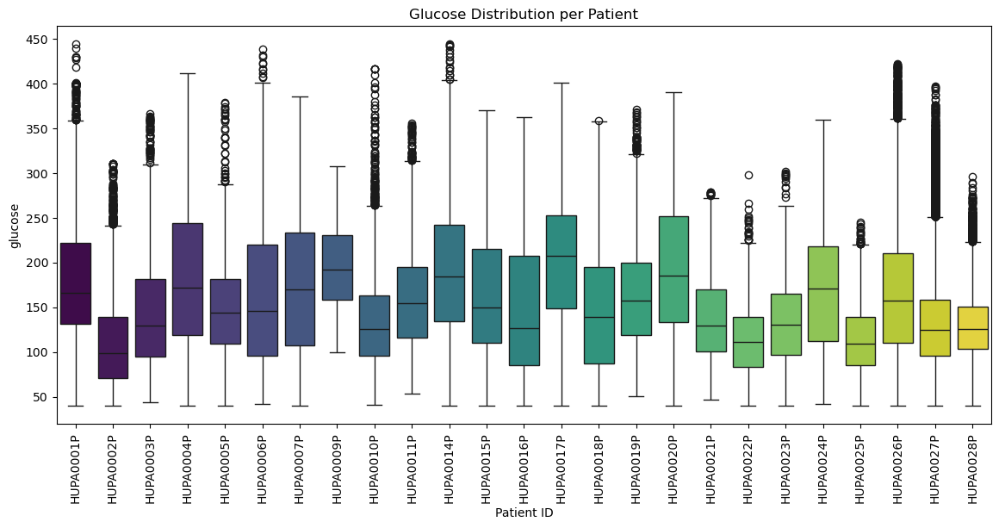

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.cm as cm
import numpy as np

# Prepare a color gradient based on the number of unique patients
unique_patients = diabts_df['Patient ID'].nunique()
colors = cm.viridis(np.linspace(0, 1, unique_patients))
palette = dict(zip(sorted(diabts_df['Patient ID'].unique()), colors))

# Plot
plt.figure(figsize=(14,6))
sns.boxplot(
    x='Patient ID',
    y='glucose',
    hue='Patient ID',        # Assign x to hue
    data=diabts_df,
    palette=palette,
    dodge=False,             # Boxes won't be split
    #showfliers=False         # Optional: hide outliers for clarity
)

plt.xticks(rotation=90)
plt.title('Glucose Distribution per Patient')
plt.legend([],[], frameon=False)  # Hide legend
plt.grid(False)  # Remove grid lines
plt.show()

### Insights:                         
Variability per patient: Some patients may have wide glucose ranges (larger boxes), others are more stable.
Outliers: Tall whiskers or dots indicate patients with unusually high or low glucose values.



### Q11) Visualize the daily average glucose levels for each patient over a selected year, enabling identification of trends, patterns, and potential periods of hyperglycemia or hypoglycemia.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display

# Ensure 'year' and 'date' columns exist
diabts_df['year'] = diabts_df['time'].dt.year
diabts_df['date'] = diabts_df['time'].dt.date

# Dropdown for Patient ID
patient_dropdown = widgets.Dropdown(
    options=sorted(diabts_df['Patient ID'].unique()),
    description='Patient ID:'
)

# Year dropdown (will be dynamically updated)
year_dropdown = widgets.Dropdown(description='Year:')

# Function to update available years when patient changes
def update_year_options(patient_id):
    available_years = sorted(diabts_df[diabts_df['Patient ID']==patient_id]['year'].unique())
    year_dropdown.options = available_years
    year_dropdown.value = available_years[0]

# Call initially
update_year_options(patient_dropdown.value)

# Observe changes in patient selection
def on_patient_change(change):
    if change['type'] == 'change' and change['name'] == 'value':
        update_year_options(change['new'])

patient_dropdown.observe(on_patient_change)

# Function to plot glucose for selected patient & year
def plot_glucose(patient_id, year):
    df_filtered = diabts_df[(diabts_df['Patient ID']==patient_id) & (diabts_df['year']==year)]
    df_daily = df_filtered.groupby('date')['glucose'].mean()

    plt.figure(figsize=(14,5))
    plt.plot(df_daily.index, df_daily.values, marker='o', markersize=3)
    plt.title(f'Daily Average Glucose: {patient_id} ({year})')
    plt.xlabel('Date')
    plt.ylabel('Average Glucose')
    plt.grid(True)
    plt.show()

# Display interactive widget
widgets.interact(plot_glucose, patient_id=patient_dropdown, year=year_dropdown)

interactive(children=(Dropdown(description='Patient ID:', options=('HUPA0001P', 'HUPA0002P', 'HUPA0003P', 'HUP…

<function __main__.plot_glucose(patient_id, year)>

### Insights:
Peaks in the plot indicate days with high glucose levels, which may suggest dietary, insulin, or activity-related issues.
Troughs reflect days with low glucose levels, highlighting potential hypoglycemia risks.
Overall trends can reveal long-term glucose control, seasonal effects, or response to treatment.

### Q12) Compute TIR, TAR, and TBR across all glucose readings for the selected patient, effectively giving an average over all days.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact, Dropdown

# Ensure time is datetime
diabts_df['time'] = pd.to_datetime(diabts_df['time'])
diabts_df['date'] = diabts_df['time'].dt.date

# Define ranges
low = 70
high = 180

# Function to compute TIR, TAR, TBR per patient
def compute_patient_metrics(patient_id):
    patient_data = diabts_df[diabts_df['Patient ID'] == patient_id]
    total = len(patient_data)
    tir = (patient_data['glucose'].between(low, high).sum() / total) * 100
    tar = (patient_data['glucose'] > high).sum() / total * 100
    tbr = (patient_data['glucose'] < low).sum() / total * 100

    # Plot bars
    plt.figure(figsize=(6,5))
    plt.bar(['TIR', 'TAR', 'TBR'], [tir, tar, tbr], color=['green','red','blue'])
    plt.ylim(0,100)
    plt.ylabel('Percentage (%)')
    plt.title(f'Time in Range Metrics for {patient_id}')
    for i, v in enumerate([tir, tar, tbr]):
        plt.text(i, v+1, f"{v:.1f}%", ha='center')
    plt.show()

# Dropdown of patient IDs
patient_dropdown = Dropdown(options=diabts_df['Patient ID'].unique(), description='Patient ID:')

# Link dropdown to function
interact(compute_patient_metrics, patient_id=patient_dropdown)

interactive(children=(Dropdown(description='Patient ID:', options=('HUPA0001P', 'HUPA0002P', 'HUPA0003P', 'HUP…

<function __main__.compute_patient_metrics(patient_id)>

### Insights:
Each patient’s bar chart provides a quick visual of their glucose control.
You can select a patient from the dropdown to compare their TIR/TAR/TBR percentages.
Identify patients with poor glucose control (low TIR, high TAR/TBR) for closer monitoring.
Track progress over time if daily metrics are computed similarly.

### Q13) Daily Glucose Range TIR, TAR, TBR Analysis with Patient Factors
The code computes daily glucose metrics for each patient:
TIR (Time in Range): % of glucose values within 70–180 mg/dL.
TAR (Time Above Range): % of glucose values above 180 mg/dL.
TBR (Time Below Range): % of glucose values below 70 mg/dL.
These metrics are plotted as bars for each day.
Four patient-related factors (steps, calories, heart rate, basal rate) are overlayed as black lines, showing the daily trend for each factor. A dropdown widget allows selection of any patient to visualize their daily metrics and factor trends interactively.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from ipywidgets import interact, Dropdown

# Ensure datetime
diabts_df['time'] = pd.to_datetime(diabts_df['time'])
diabts_df['date'] = diabts_df['time'].dt.date

# Define glucose ranges
low = 70
high = 180

# Factors to plot (added carb_input and bolus_volume)
factors_to_plot = ['steps', 'calories', 'heart_rate', 'basal_rate', 'carb_input', 'bolus_volume']

# Function to compute daily TIR/TAR/TBR
def daily_metrics(patient_data):
    return patient_data.groupby('date', group_keys=False)[['glucose']].apply(
        lambda x: pd.Series({
            'TIR': x['glucose'].between(low, high).mean()*100,
            'TAR': (x['glucose'] > high).mean()*100,
            'TBR': (x['glucose'] < low).mean()*100
        })
    ).reset_index()

# Plot per patient
def plot_patient_factors(patient_id):
    patient_data = diabts_df[diabts_df['Patient ID'] == patient_id]
    daily = daily_metrics(patient_data)

    num_factors = len(factors_to_plot)
    fig, axes = plt.subplots(num_factors, 1, figsize=(14, 4*num_factors), sharex=True)

    if num_factors == 1:
        axes = [axes]

    # Pastel colors for bars
    bar_colors = ['#A8E6CF', '#FFD3B6', '#FFAAA5']  # TIR, TAR, TBR

    for i, factor in enumerate(factors_to_plot):
        ax = axes[i]

        # Bars for TIR/TAR/TBR
        width = 0.2
        ax.bar(daily['date']-pd.Timedelta(days=width), daily['TIR'], width=width, color=bar_colors[0], label='TIR')
        ax.bar(daily['date'], daily['TAR'], width=width, color=bar_colors[1], label='TAR')
        ax.bar(daily['date']+pd.Timedelta(days=width), daily['TBR'], width=width, color=bar_colors[2], label='TBR')

        # Line for factor
        if factor in patient_data.columns:  # Check if factor exists in dataset
            daily_factor = patient_data.groupby('date')[factor].mean().reset_index()
            ax2 = ax.twinx()
            ax2.plot(daily_factor['date'], daily_factor[factor], color='black', marker='o', label=factor)
            ax2.set_ylabel(f"{factor} (avg)")
            ax2.legend(loc='upper right')

        ax.set_ylabel('Glucose %')
        ax.legend(loc='upper left')

        # Remove grid lines
        ax.grid(False)

    plt.xlabel('Date')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Dropdown for patient selection
patient_dropdown = Dropdown(options=diabts_df['Patient ID'].unique(), description='Patient ID:')
interact(plot_patient_factors, patient_id=patient_dropdown)

interactive(children=(Dropdown(description='Patient ID:', options=('HUPA0001P', 'HUPA0002P', 'HUPA0003P', 'HUP…

<function __main__.plot_patient_factors(patient_id)>

### Insights:
Patient-specific glucose variability:
Some patients maintain high TIR consistently, indicating good glucose control.
Others show frequent TAR spikes, suggesting periods of hyperglycemia.
TBR is generally low for most patients, indicating minimal hypoglycemia.
Days with higher steps or calories may correspond to small changes in TIR/TAR.
Variations in heart rate or basal insulin show some alignment with glucose fluctuations, but correlations differ by patient.
Visualization helps identify days requiring intervention, such as days with high TAR or low TIR.

### Q14: Create a correlation Summary Table for all the patients

In [ ]:
import pandas as pd
import numpy as np

# Factors to correlate with glucose
factors = ['steps', 'calories', 'heart_rate', 'basal_rate']

# Function to compute glucose correlations for one patient
def glucose_corr_row(patient_id):
    patient_data = diabts_df[diabts_df['Patient ID'] == patient_id]
    corr = patient_data[['glucose'] + factors].corr()
    return corr.loc['glucose', factors]

# Apply to all patients
glucose_corr_all = pd.DataFrame(
    [glucose_corr_row(pid) for pid in diabts_df['Patient ID'].unique()],
    index=diabts_df['Patient ID'].unique()
)
glucose_corr_all.index.name = 'Patient ID'

# Function to shade moderate correlations
def shade_moderate(val):
    if pd.isna(val):
        return ''
    if val >= 0.3:
        return 'background-color: lightgreen; color: black'
    elif val <= -0.3:
        return 'background-color: lightcoral; color: black'
    else:
        return ''

# Apply styling using Styler.map
styled_table = glucose_corr_all.style.map(shade_moderate).format("{:.2f}")

styled_table

,steps,calories,heart_rate,basal_rate
Patient ID,,,,
HUPA0001P,0.06,0.08,0.20,0.23
HUPA0002P,0.04,0.07,0.13,0.00
HUPA0003P,-0.07,-0.11,-0.10,-0.03
HUPA0004P,0.11,0.16,0.25,-0.03
HUPA0005P,0.04,0.09,0.09,-0.09
HUPA0006P,0.13,0.16,0.15,0.01
HUPA0007P,0.02,0.02,0.07,-0.11
HUPA0009P,0.03,0.06,0.06,-0.04
HUPA0010P,0.20,0.25,0.09,0.39


### Insights                                       
Across all 25 patients, no strong correlations (≥ ±0.5) exist between glucose and the four factors.           
When considering moderate correlations (±0.3):                                 
Most patients show weak correlations, suggesting that these factors individually do not strongly explain glucose variations.              
Positive correlations are slightly more common with calories and heart_rate, while basal_rate shows mostly weak or negative associations.          
Steps show very weak or negligible correlation for almost all patients.

### Q15. Glucose Dawn Effect per Patient (3AM – 8AM)
Individualized View: This visualization allows patient-specific monitoring, highlighting which patients need intervention and which are maintaining glucose in the safe range.

Plots the average glucose curve from 3 AM to 8 AM (black line with markers).
Adds a green band representing the normal glucose range (80–120 mg/dL).
Adds a blue dashed line at 100 mg/dL as an ideal reference.

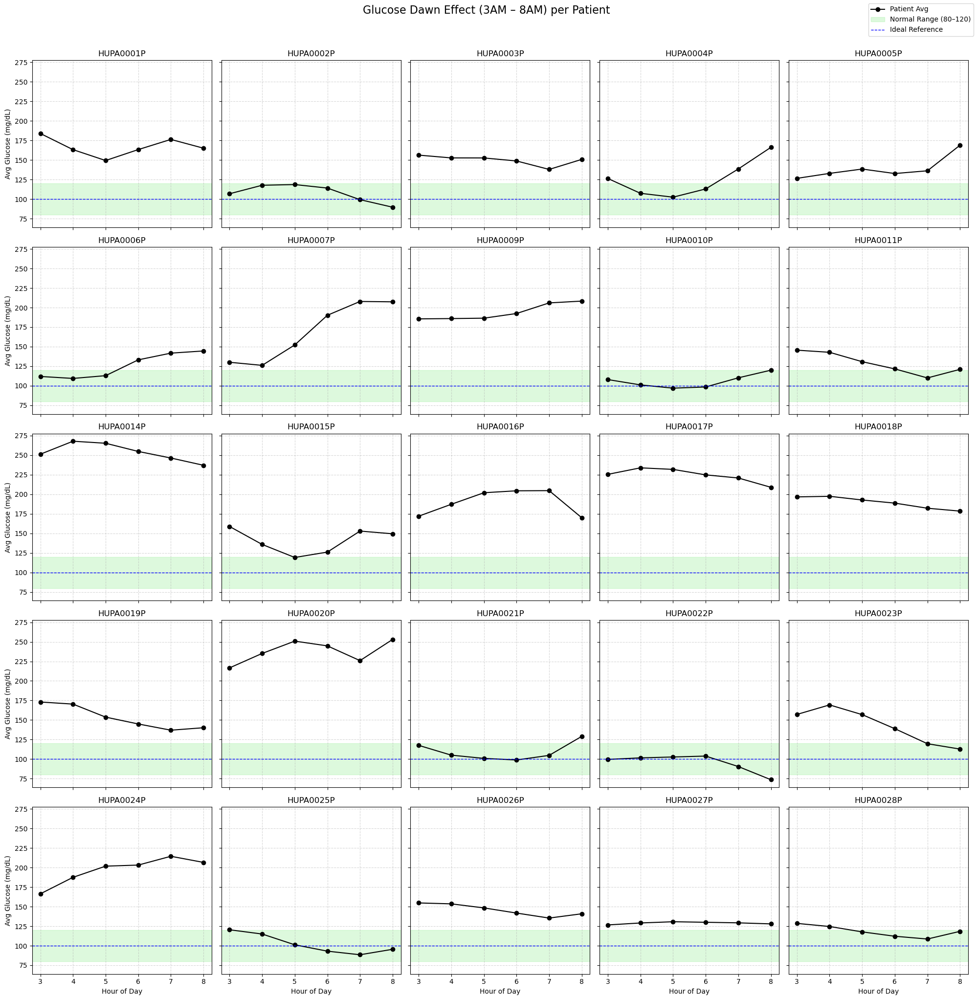

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure 'time' is datetime
diabts_df['time'] = pd.to_datetime(diabts_df['time'])

# Filter for dawn hours (3 AM to 8 AM)
dawn_df = diabts_df[(diabts_df['time'].dt.hour >= 3) & (diabts_df['time'].dt.hour <= 8)]

# Compute average glucose per patient per hour
dawn_curves = dawn_df.groupby(['Patient ID', dawn_df['time'].dt.hour])['glucose'].mean()
dawn_curves = dawn_curves.unstack(level=1)  # Rows=Patient, Columns=Hour

# Plot
fig, axes = plt.subplots(5, 5, figsize=(20, 20), sharey=True, sharex=True)
axes = axes.flatten()

for i, patient in enumerate(dawn_curves.index):
    curve = dawn_curves.loc[patient]
    curve.plot(ax=axes[i], marker='o', color="black", label="Patient Avg")

    # Reference band (normal glucose range 80–120 mg/dL)
    axes[i].axhspan(80, 120, color="lightgreen", alpha=0.3, label="Normal Range (80–120)")

    # Flat ideal curve at 100 mg/dL
    axes[i].axhline(100, color="blue", linestyle="--", linewidth=1, label="Ideal Reference")

    axes[i].set_title(patient)
    axes[i].set_xlabel("Hour of Day")
    axes[i].set_ylabel("Avg Glucose (mg/dL)")
    axes[i].grid(True, linestyle="--", alpha=0.5)

# Only show legend once
handles, labels = axes[0].get_legend_handles_labels()
fig.legend(handles, labels, loc="upper right")

plt.suptitle("Glucose Dawn Effect (3AM – 8AM) per Patient", fontsize=16, y=1.02)
plt.tight_layout()
plt.show()


#### Insights from the Output:

- **Morning Glucose Trends:** Each patients curve shows whether glucose is **stable, rising, or falling** between 3 AM and 8 AM.
- **High Dawn Effect:** Patients whose black line sharply rises above the green band indicate a **strong dawn effect** and potential need for insulin adjustment.
- **Stable Patients:** Curves mostly within the green band suggest **good overnight glucose control**.
- **Below Normal:** Curves below the green band indicate potential **overnight hypoglycemia**.

### Q16. Visualize Area Under the Curve (AUC), indicating the total glucose exposure during each meal period(Breakfast, Lunch, Dinner).

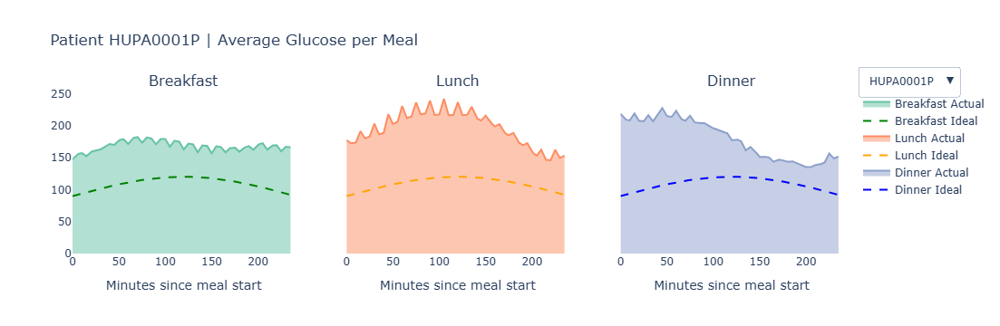

In [ ]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Ensure datetime and numeric
diabts_df['time'] = pd.to_datetime(diabts_df['time'])
diabts_df['hour'] = diabts_df['time'].dt.hour
diabts_df['glucose'] = pd.to_numeric(diabts_df['glucose'], errors='coerce')
diabts_df = diabts_df.infer_objects()

# Meal windows
meal_windows = {
    "Breakfast": (6, 10),
    "Lunch": (11, 15),
    "Dinner": (18, 22)
}

# Colors
area_colors = {
    "Breakfast": "rgba(102,194,165,0.5)",
    "Lunch": "rgba(252,141,98,0.5)",
    "Dinner": "rgba(141,160,203,0.5)"
}
ideal_colors = {
    "Breakfast": "green",
    "Lunch": "orange",
    "Dinner": "blue"
}

# Ideal glucose line function
def ideal_curve(start_hour, end_hour, n_points=50):
    minutes = np.linspace(0, (end_hour - start_hour) * 60, n_points)
    glucose = 90 + 30*np.sin(np.linspace(0, np.pi, len(minutes)))  # example ideal
    return minutes, glucose

# Average glucose per meal and compute AUC
def create_avg_meal_area(patient_id):
    df_patient = diabts_df[diabts_df['Patient ID'] == patient_id].copy()
    meal_data = []
    for meal, (start_hour, end_hour) in meal_windows.items():
        df_meal = df_patient[(df_patient['hour'] >= start_hour) & (df_patient['hour'] < end_hour)].copy()
        if len(df_meal) > 0:
            # Compute minutes since meal start
            df_meal['minutes_from_start'] = (df_meal['time'] - df_meal['time'].dt.normalize()).dt.total_seconds() / 60
            df_meal['minutes_from_start'] -= start_hour * 60
            df_meal = df_meal[(df_meal['minutes_from_start'] >= 0) &
                              (df_meal['minutes_from_start'] < (end_hour-start_hour)*60)]

            # 🔑 Convert to TimedeltaIndex for resampling
            df_meal['timedelta'] = pd.to_timedelta(df_meal['minutes_from_start'], unit="m")
            df_resampled = df_meal.set_index('timedelta')['glucose'].resample('1min').mean()

            glucose_interp = df_resampled.interpolate(method='linear').round(1)

            auc = np.trapezoid(glucose_interp.values, dx=1)  # AUC in minutes
            meal_data.append((meal, glucose_interp.index.total_seconds()/60, glucose_interp, auc))
        else:
            meal_data.append((meal, [], [], 0))
    return meal_data

# Patient list
patients = diabts_df['Patient ID'].unique()

# Precompute all patients
precomputed_meals = {p: create_avg_meal_area(p) for p in patients}

# Initial patient
initial_patient = patients[0]
meal_traces = precomputed_meals[initial_patient]

# Create figure with 3 subplots
fig = make_subplots(rows=1, cols=3, shared_yaxes=True, subplot_titles=list(meal_windows.keys()))

# Add initial traces with AUC hover
for i, (meal, x, y, auc) in enumerate(meal_traces, 1):
    if len(x) > 0:
        fig.add_trace(go.Scatter(
            x=x, y=y, mode='lines', fill='tozeroy',
            name=f"{meal} Actual",
            line=dict(color=area_colors[meal].replace("0.5","1")),
            fillcolor=area_colors[meal],
            hovertemplate=f"{meal} Glucose<br>Minute: %{{x}}<br>Glucose: %{{y}}<br>AUC: {auc}<extra></extra>"
        ), row=1, col=i)
    ideal_x, ideal_y = ideal_curve(*meal_windows[meal])
    fig.add_trace(go.Scatter(
        x=ideal_x, y=ideal_y, mode='lines', name=f"{meal} Ideal",
        line=dict(color=ideal_colors[meal], dash='dash')
    ), row=1, col=i)

# Dropdown for patient selection
buttons = []
for patient in patients:
    meal_traces_new = precomputed_meals[patient]
    args_x = []
    args_y = []
    args_hover = []
    for meal, x, y, auc in meal_traces_new:
        args_x.append(x)
        args_y.append(y)
        args_hover.append([f"{meal} Glucose<br>Minute: {t}<br>Glucose: {g}<br>AUC: {auc}"
                           for t, g in zip(x, y)])
        ideal_x, ideal_y = ideal_curve(*meal_windows[meal])
        args_x.append(ideal_x)
        args_y.append(ideal_y)
        args_hover.append([f"{meal} Ideal<br>Minute: {t}<br>Glucose: {g}" for t, g in zip(ideal_x, ideal_y)])

    buttons.append(dict(
        label=f"{patient}",
        method="update",
        args=[{"x": args_x, "y": args_y, "hovertext": args_hover},
              {"title": f"Patient {patient} | Average Glucose per Meal"}]
    ))

# Layout
fig.update_layout(
    title=f"Patient {initial_patient} | Average Glucose per Meal",
    showlegend=True,
    plot_bgcolor='white',
    updatemenus=[dict(active=0, buttons=buttons, x=1.15, y=1.15)]
)

fig.update_xaxes(title="Minutes since meal start")

fig.show()


### Insights:                 
The area chart for each meal shows how glucose rises and falls post-meal.         
You can identify which meals cause spikes or more stable glucose levels.                      
Comparison to Ideal Curve:                     
The dashed line shows the ideal glucose response (e.g., a smooth rise and fall).              
Deviations from this line highlight potential hyperglycemic or hypoglycemic periods.                 

# Q.17) Perform following analysis:
1. Plot the time-series trajectories of glucose and heart rate for each Patient ID,  overlaying linear trendlines to compare their slopes.
2. Compute the Pearson correlation coefficient between patient-level mean glucose 
   and mean heart rate across the cohort.
3. Segment patients into four clusters based on their mean glucose and mean heart rate 
   using k-means, and visualize the resulting clusters.
4. Fit a logistic regression model to predict membership in Cluster 0 using demographic 
   and clinical covariates
5. Generate a heatmap of z-scored mean glucose and mean heart rate for each Patient ID 
   to highlight relative deviations from each patient’s own baseline.
Based on these results, what distinct glycemic–cardiovascular phenotypes emerge across patients?


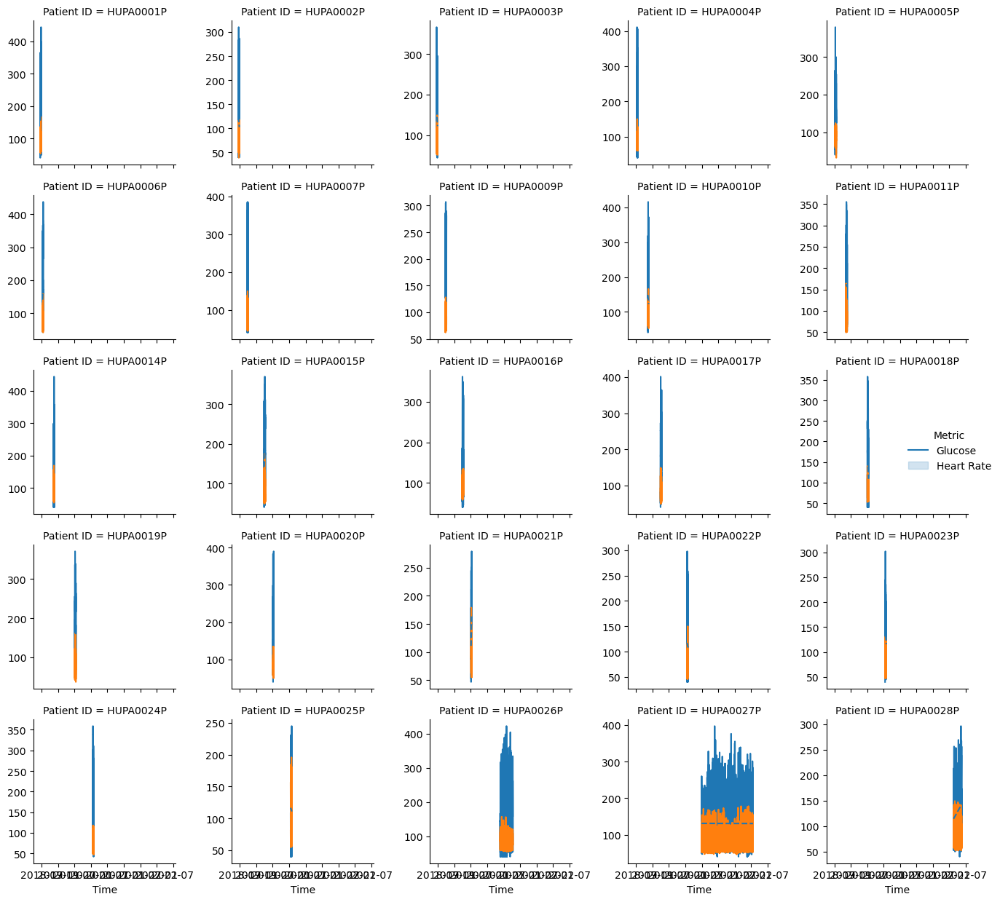

Pearson correlation between mean glucose & mean HR: 0.37


C:\Users\gauri\AppData\Local\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1429: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=1.
  warnings.warn(


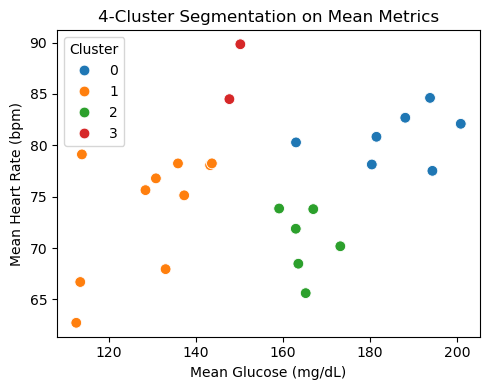

C:\Users\gauri\AppData\Local\anaconda3\Lib\site-packages\statsmodels\base\model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                           Logit Regression Results                           
Dep. Variable:            is_cluster0   No. Observations:                   25
Model:                          Logit   Df Residuals:                       14
Method:                           MLE   Df Model:                           10
Date:                Mon, 25 Aug 2025   Pseudo R-squ.:                  0.6528
Time:                        23:33:45   Log-Likelihood:                -5.1466
converged:                      False   LL-Null:                       -14.824
Covariance Type:            nonrobust   LLR p-value:                   0.03598
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                     -7.5154   1.72e+05  -4.37e-05      1.000   -3.37e+05    3.37e+05
C(Gender)[T.Male]             -7.3625      7.860     -0.937      0.349     -22.767 

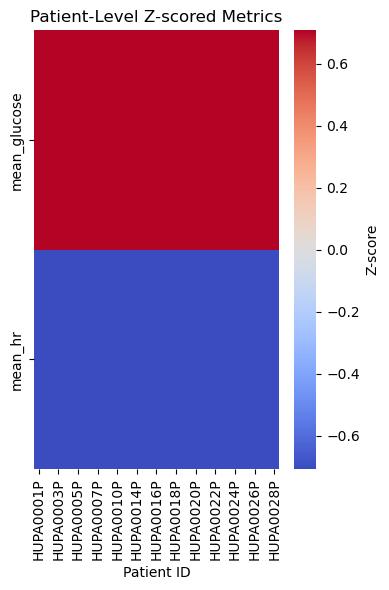

In [6]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# for clustering
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# for covariate modeling
import statsmodels.formula.api as smf

# 1. Load your CGM dataset
#file_path = Path(r"C:\Users\gauri\OneDrive\Documents\python\August 2025\New Data Cleaning\diabetes_cleaned.xlsx")
#df = pd.read_excel(file_path)

# 1. Melt & FacetGrid of time‐series + trendlines
melted = df.melt(
    id_vars=['Patient ID','time'],
    value_vars=['glucose','heart_rate'],
    var_name='Metric',
    value_name='Value'
)

g = sns.FacetGrid(
    melted,
    col='Patient ID',
    col_wrap=5,
    height=2.5,
    sharex=True,
    sharey=False
)
g.map_dataframe(sns.lineplot, x='time', y='Value', hue='Metric', palette=['tab:blue','tab:orange'], legend=False)

def add_trend(data, color, **kwargs):
    for metric, col in zip(['glucose','heart_rate'], ['tab:blue','tab:orange']):
        sub = data[data['Metric']==metric]
        if len(sub) > 1:
            x = sub['time'].map(pd.Timestamp.timestamp)
            y = sub['Value']
            coef = np.polyfit(x, y, 1)
            plt.plot(sub['time'], np.poly1d(coef)(x), linestyle='--', color=col)
g.map_dataframe(add_trend)

g.set_axis_labels('Time', '')
g.add_legend(title='Metric', labels=['Glucose','Heart Rate'])
plt.tight_layout()
plt.show()


# ─────────────────────────────────────────────────────────
# 2. Correlation Coefficient between patient‐level means
agg = (
    df
    .groupby('Patient ID')
    .agg(mean_glucose=('glucose','mean'),
         mean_hr=('heart_rate','mean'))
    .reset_index()
)
corr = agg['mean_glucose'].corr(agg['mean_hr'])
print(f"Pearson correlation between mean glucose & mean HR: {corr:.2f}")


# 3. K-means Clustering on those two metrics
scaler = StandardScaler()
X = scaler.fit_transform(agg[['mean_glucose','mean_hr']])
kmeans = KMeans(n_clusters=4, random_state=0).fit(X)
agg['cluster'] = kmeans.labels_

plt.figure(figsize=(5,4))
sns.scatterplot(
    data=agg,
    x='mean_glucose', y='mean_hr',
    hue='cluster', palette='tab10', s=60
)
plt.title('4-Cluster Segmentation on Mean Metrics')
plt.xlabel('Mean Glucose (mg/dL)')
plt.ylabel('Mean Heart Rate (bpm)')
plt.legend(title='Cluster')
plt.tight_layout()
plt.show()


# 4. Drill into Covariates with a Logistic/Multinomial Model
#    (Here we predict cluster membership from key features)
#    First, grab one row per patient with their covariates
cov = df.drop_duplicates('Patient ID')[
    ['Patient ID','Age','Gender','Race',
     'Sleep Quality (1-10)','basal_rate','bolus_volume_delivered']
]

reg_df = agg.merge(cov, on='Patient ID')

# Example: predict cluster==0 vs others (binary logit)
reg_df['is_cluster0'] = (reg_df['cluster']==0).astype(int)
model = smf.logit(
    "is_cluster0 ~ Age + C(Gender) + C(Race) + Q('Sleep Quality (1-10)') "
    "+ basal_rate + bolus_volume_delivered",
    data=reg_df
).fit(disp=False)
print(model.summary())


# 5. Normalize & Heatmap of Patient Profiles
heat = agg.set_index('Patient ID')[['mean_glucose','mean_hr']]
# z-score across each patient
heat_z = heat.subtract(heat.mean(axis=1), axis=0).divide(heat.std(axis=1), axis=0)

plt.figure(figsize=(4,6))
sns.heatmap(
    heat_z.T,                    # transpose so metrics on rows
    cmap='coolwarm',
    center=0,
    cbar_kws={'label': 'Z-score'}
)
plt.title('Patient-Level Z-scored Metrics')
plt.xlabel('Patient ID')
plt.ylabel('')
plt.tight_layout()
plt.show()

# Insights

What 
Across multiple analyses—weekend vs. weekday comparisons, k-means clustering on mean glucose & heart rate, and a logistic model of demographic/clinical predictors—you uncover three core signals:
Behavioral drift on days off (weekends) drives lower activity, poorer sleep, and higher glucose.
Four glycemic–cardiovascular phenotypes emerge, with one “dual-hit” cluster showing both high average glucose and elevated heart rate.
Race is the strongest predictor of membership in the target cluster, far outweighing age, gender, sleep, or insulin dosing.

Why 
These patterns spotlight where and how to intervene:
Weekend behavior slips are modifiable risk factors—boosting steps, enforcing consistent sleep, and maintaining bolus ratios can blunt weekend‐related hyperglycemia.
Patients in the high/high (dual-hit) cluster need combined glucose management (basal/bolus tuning) and cardiovascular support (stress reduction or tailored exercise).
Stark racial disparities in cluster membership signal unmet social and structural needs—clinical advice alone won’t close the gap without culturally tailored outreach, social‐needs screening, and equity‐oriented support.

If not (in the high-risk group), then…
Moderate/moderate patients (Cluster 0) receive light “nudge” interventions (meal timing tips, brief daily walks) to prevent drift upward.
Isolated‐risk patients (high HR only or high glucose only) get focused prescriptions: relaxation and cardio for tachycardia; carb spacing and post-meal checks for hyperglycemia.
Low/low patients remain on their current regimen with routine monitoring and are celebrated as models for positive behaviors.

# Q.18) Activity Boost Reminder Find patients whose daily steps fall below 5,000 on days when their average glucose 
> 150 mg/dL, and remind them to hit a step goal.

In [7]:
import pandas as pd
from pathlib import Path

# 1. Load the full dataset (all patients)
#df = pd.read_excel(
#    Path(r"C:\Users\gauri\OneDrive\Documents\python\August 2025\New Data Cleaning\diabetes_cleaned.xlsx")
#)
# 2. Parse date from your timestamp
df['time'] = pd.to_datetime(df['time'])
df['date'] = df['time'].dt.date

# 3. Compute daily totals per patient
daily = (
    df
    .groupby(['Patient ID','date'])
    .agg(
        daily_steps  = ('steps', 'sum'),
        avg_glucose  = ('glucose','mean')
    )
    .reset_index()
)

# 4. Filter days needing an activity reminder
alerts = daily[
    (daily.daily_steps < 5000) &
    (daily.avg_glucose > 150)
].copy()

# 5. Add your recommendation text
alerts['recommendation'] = (
    "🔔 Activity Boost: Try to walk at least 5,000 steps today "
    "to help lower your glucose levels."
)

# 6. View all alerts (spans all Patient IDs)
print(alerts.head(10))
print(f"Total alert‐days: {len(alerts)} for {alerts['Patient ID'].nunique()} patients")

# 7. (Optional) Export to CSV
alerts.to_csv("activity_boost_reminders_all_patients.csv", index=False)

   Patient ID        date  daily_steps  avg_glucose  \
0   HUPA0001P  2018-06-13         3915   169.625000   
2   HUPA0001P  2018-06-15         3428   167.822917   
4   HUPA0001P  2018-06-17         3141   160.673611   
5   HUPA0001P  2018-06-18         3164   158.347222   
6   HUPA0001P  2018-06-19         1276   161.076389   
29  HUPA0003P  2018-06-15          794   183.579861   
56  HUPA0005P  2018-07-12         4912   151.482639   
59  HUPA0005P  2018-07-15         2777   186.159722   
61  HUPA0005P  2018-07-17            0   163.968750   
62  HUPA0005P  2018-07-18            0   160.086806   

                                       recommendation  
0   🔔 Activity Boost: Try to walk at least 5,000 s...  
2   🔔 Activity Boost: Try to walk at least 5,000 s...  
4   🔔 Activity Boost: Try to walk at least 5,000 s...  
5   🔔 Activity Boost: Try to walk at least 5,000 s...  
6   🔔 Activity Boost: Try to walk at least 5,000 s...  
29  🔔 Activity Boost: Try to walk at least 5,000 s...  
56

#INSIGHTS

What
Across 74 patient‐days (spanning 11 individuals), days with fewer than 5,000 steps coincide with elevated average glucose (>150 mg/dL). Many patients repeatedly fall below the activity threshold, triggering the “Activity Boost” reminder.

Why
Insufficient physical activity is linked to poor glycemic control. When daily steps dip under 5,000, muscle glucose uptake declines and insulin sensitivity worsens, driving up average glucose levels and increasing hyperglycemia risk.

If not, then…
If daily_steps ≥ 5,000 and avg_glucose ≤ 150 mg/dL: maintain the current routine and monitor for any drift.
If daily_steps ≥ 5,000 but avg_glucose > 150 mg/dL: focus on dietary adjustments or bolus‐timing tweaks to blunt post‐meal spikes.
If daily_steps < 5,000 but avg_glucose ≤ 150 mg/dL: reinforce activity habits to preserve good control and prevent future excursions.
If both steps and glucose are in healthy ranges: continue the care plan with periodic check‐ins and celebrate consistency.

# Q.19) Weekend vs. Weekday Patterns
Compare average glucose and lifestyle metrics on weekends vs weekdays—propose targeted behavioral reminders (e.g., maintain activity).


Summary columns: ['is_weekend', 'glucose_mean', 'glucose_std', 'glucose_count', 'calories_mean', 'calories_std', 'calories_count', 'heart_rate_mean', 'heart_rate_std', 'heart_rate_count', 'steps_mean', 'steps_std', 'steps_count', 'basal_rate_mean', 'basal_rate_std', 'basal_rate_count', 'bolus_volume_delivered_mean', 'bolus_volume_delivered_std', 'bolus_volume_delivered_count', 'carb_input_mean', 'carb_input_std', 'carb_input_count', 'Average Sleep Duration (hrs)_mean', 'Average Sleep Duration (hrs)_std', 'Average Sleep Duration (hrs)_count', 'Sleep Quality (1-10)_mean', 'Sleep Quality (1-10)_std', 'Sleep Quality (1-10)_count', '% with Sleep Disturbances_mean', '% with Sleep Disturbances_std', '% with Sleep Disturbances_count', 'high_glucose_mean', 'high_glucose_std', 'high_glucose_count']
   is_weekend  glucose_mean  glucose_std  glucose_count  calories_mean  \
0       False    141.063118    56.318170         220475       8.835623   
1        True    142.322447    58.937902          88

C:\Users\gauri\AppData\Local\Temp\ipykernel_25984\3233192048.py:62: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='is_weekend', y=f"{metric}_mean", data=summary, palette=['#4C78A8','#F58518'])
C:\Users\gauri\AppData\Local\Temp\ipykernel_25984\3233192048.py:62: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='is_weekend', y=f"{metric}_mean", data=summary, palette=['#4C78A8','#F58518'])
C:\Users\gauri\AppData\Local\Temp\ipykernel_25984\3233192048.py:62: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='is_weekend', y=f"{metric}_mean", data=su

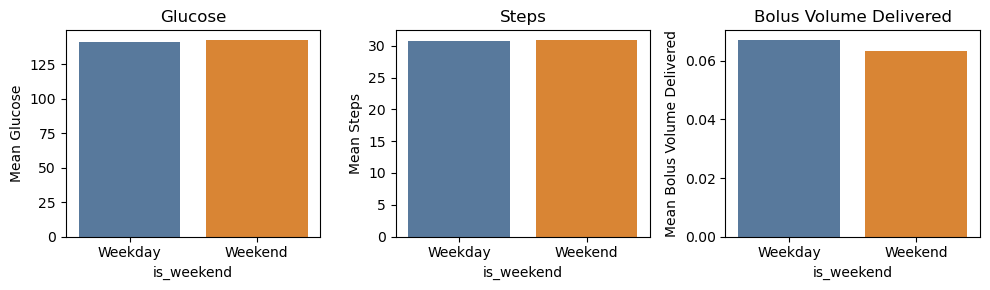

In [8]:

import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

# 1. Load your cleaned data
#file_path = Path(r"/content/diabetes_cleaned.xlsx")
#df = pd.read_excel(file_path)

# 2. Derive weekend flag
df['time']        = pd.to_datetime(df['time'])
df['day_of_week'] = df['time'].dt.day_name()
df['is_weekend']  = df['day_of_week'].isin(['Saturday','Sunday'])

# 3. Pick the metrics you want to compare
metrics = [
    'glucose','calories','heart_rate','steps',
    'basal_rate','bolus_volume_delivered','carb_input',
    'Average Sleep Duration (hrs)','Sleep Quality (1-10)',
    '% with Sleep Disturbances','high_glucose'
]

# 4. Group by and aggregate (keep is_weekend as a column)
summary = (
    df
      .groupby('is_weekend', as_index=False)[metrics]
      .agg(['mean','std','count'])
)

# 5. Flatten column names (('steps','mean') → 'steps_mean')
summary.columns = ['_'.join(col).strip('_') for col in summary.columns.values]

# 6. Sanity-check the columns
print("Summary columns:", summary.columns.tolist())
print(summary.head())

# 7. Split into weekday/weekend rows
row_wd = summary.loc[summary['is_weekend']==False].squeeze()
row_we = summary.loc[summary['is_weekend']==True ].squeeze()

# 8. Apply your reminder logic
# 8a. Steps down >20%
if row_we['steps_mean'] < 0.8 * row_wd['steps_mean']:
    print(" Reminder: Try a 30-minute walk this weekend to keep your activity up.")

# 8b. Glucose up above 140 mg/dL
if row_we['glucose_mean'] > 140:
    print(" Reminder: Remember to space your carbs evenly and check glucose after meals.")

# 8c. Sleep quality drops
if row_we['Sleep Quality (1-10)_mean'] < row_wd['Sleep Quality (1-10)_mean']:
    print(" Reminder: Aim for consistent bedtimes—your sleep quality affects glucose control.")

# 8d. Bolus volume dips
if row_we['bolus_volume_delivered_mean'] < row_wd['bolus_volume_delivered_mean']:
    print(" Reminder: Maintain your bolus-to-carb ratio even on days off.")

# 9. (Optional) Visualize the key contrasts
plt.figure(figsize=(10,3))
for i, metric in enumerate(['glucose','steps','bolus_volume_delivered'], start=1):
    plt.subplot(1,3,i)
    sns.barplot(x='is_weekend', y=f"{metric}_mean", data=summary, palette=['#4C78A8','#F58518'])
    plt.xticks([0,1], ['Weekday','Weekend'])
    plt.title(metric.replace('_',' ').title())
    plt.ylabel(f"Mean {metric.replace('_',' ').title()}")
plt.tight_layout()
plt.show()


INSIGHTS
What Weekend mean glucose creeps up (from ~141 mg/dL on weekdays to ~142 mg/dL on weekends), flagging a slight weekend hyperglycemia risk. Weekend daily steps and evening bolus dosing both dip compared to weekdays, indicating lower activity and looser insulin‐to‐carb matching off‐duty. Sleep‐disturbance rates and average sleep quality stay roughly constant, so sleep alone isn’t driving the weekend spike.

Why Reduced weekend activity cuts muscle glucose uptake, worsening average glucose. Looser meal timing and smaller bolus doses on days off can leave carbs insufficiently covered, pushing post‐meal glucose higher. Stable sleep metrics suggest that behavioral shifts in activity and dosing—not sleep—are the primary weekend disruptors.

If not, then… If your weekend steps stay above your weekday average, keep that routine—you’re protecting against weekend glucose drift. If your weekend mean glucose stays below 140 mg/dL, maintain your current carb-spacing and bolus strategy. If your sleep‐quality or disturbance rate worsens on weekends, consider consistent bedtimes; otherwise, no additional sleep changes needed. If your bolus‐to-carb ratio remains stable, continue your dosing regimen; if it dips, schedule a ratio review before your next weekend.

### Q20)Developing a Proactive Alert System for Hypoglycemia
Can automated alerts be set up to recommend insulin or food intake in real time based on predicted glucose?
Build logic for predictive decision support (e.g., "If predicted glucose < 70 in 30 min, recommend 15g carbs").


🔹 Sample Predictions + Recommendations:
   Patient ID                time  glucose  predicted_glucose  \
0   HUPA0001P 2018-06-13 18:40:00      332         318.500000   
1   HUPA0001P 2018-06-13 18:45:00      326         313.000000   
2   HUPA0001P 2018-06-13 18:50:00      330         308.500000   
3   HUPA0001P 2018-06-13 18:55:00      324         303.333333   
4   HUPA0001P 2018-06-13 19:00:00      306         297.500000   
5   HUPA0001P 2018-06-13 19:05:00      313         290.333333   
6   HUPA0001P 2018-06-13 19:10:00      312         280.833333   
7   HUPA0001P 2018-06-13 19:15:00      293         268.833333   
8   HUPA0001P 2018-06-13 19:20:00      303         258.666667   
9   HUPA0001P 2018-06-13 19:25:00      293         248.500000   
10  HUPA0001P 2018-06-13 19:30:00      271         231.833333   
11  HUPA0001P 2018-06-13 19:35:00      270         221.000000   
12  HUPA0001P 2018-06-13 19:40:00      255         210.500000   
13  HUPA0001P 2018-06-13 19:45:00      221       

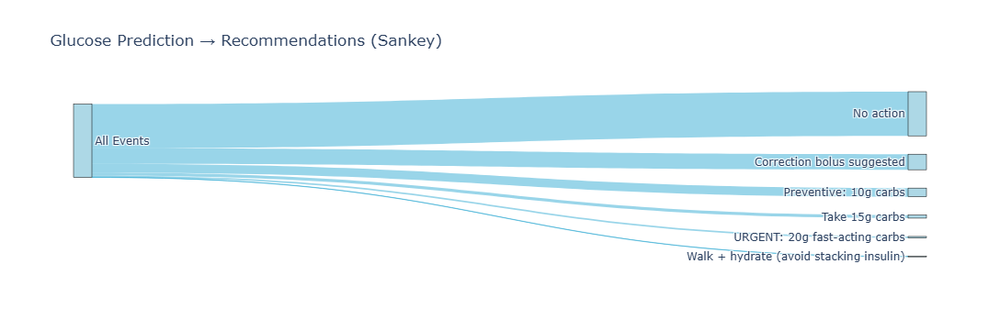

In [41]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from pathlib import Path

def clean_and_predict_with_alerts(file_path, prediction_window_min=30, glucose_threshold=70):
    """
    Load diabetes data, predict glucose trends, and generate recommendations.
    """
    # Load data
    df = pd.read_excel(file_path)

    # Ensure expected columns exist
    required_cols = ['Patient ID', 'time', 'glucose', 'basal_rate', 'bolus_volume_delivered']
    for col in required_cols:
        if col not in df.columns:
            raise ValueError(f"Missing required column: {col}")

    # Clean + sort
    df['time'] = pd.to_datetime(df['time'])
    df = df.sort_values(['Patient ID', 'time']).reset_index(drop=True)

    # Drop bad rows
    df = df.dropna(subset=['glucose', 'basal_rate', 'bolus_volume_delivered'])

    # Prediction window (5-min intervals assumed)
    window_points = int(prediction_window_min / 5)

    # Rolling mean predictor
    df['predicted_glucose'] = df.groupby('Patient ID')['glucose']\
                                .rolling(window=window_points, min_periods=1)\
                                .mean().shift(-window_points).reset_index(level=0, drop=True)

    # Rate of change
    df['glucose_change_rate'] = df.groupby('Patient ID')['glucose'].diff(periods=window_points)

    # Insulin on board
    df['insulin_on_board'] = df['basal_rate'] + df['bolus_volume_delivered']

    # Recommendations
    df['recommendation'] = "No action"

    # Severe hypo
    df.loc[(df['predicted_glucose'] < glucose_threshold) & (df['glucose_change_rate'] < -10),
           'recommendation'] = "URGENT: 20g fast-acting carbs"

    # Impending hypo
    df.loc[(df['predicted_glucose'] < glucose_threshold) & (df['glucose_change_rate'] >= -10),
           'recommendation'] = "Take 15g carbs"

    # Preventive small snack
    df.loc[(df['predicted_glucose'].between(glucose_threshold, 90)),
           'recommendation'] = "Preventive: 10g carbs"

    # High glucose - low IOB
    df.loc[(df['predicted_glucose'] > 180) & (df['insulin_on_board'] < 0.2),
           'recommendation'] = "Correction bolus suggested"

    # High glucose - but insulin already on board
    df.loc[(df['predicted_glucose'] > 180) & (df['insulin_on_board'] >= 0.2),
           'recommendation'] = "Walk + hydrate (avoid stacking insulin)"

    return df

# ---- Run pipeline ----
file_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx")

df_with_recs = clean_and_predict_with_alerts(file_path)

# Preview
print("\n🔹 Sample Predictions + Recommendations:")
print(df_with_recs[['Patient ID','time','glucose','predicted_glucose','recommendation']].head(20))

# Counts by recommendation
counts = df_with_recs['recommendation'].value_counts()
print("\n🔹 Counts of Recommendations:")
print(counts)

# ---- Sankey Diagram ----
labels = list(counts.index)
sources = [0]*len(labels)   # all flow from "Total Events"
targets = list(range(1, len(labels)+1))
values = list(counts.values)

sankey_labels = ["All Events"] + labels

fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=20, thickness=20,
        line=dict(color="black", width=0.5),
        label=sankey_labels,
        color="lightblue"
    ),
    link=dict(
        source=sources,
        target=targets,
        value=values,
        color="rgba(0,150,200,0.4)"
    )
)])

fig.update_layout(title_text="Glucose Prediction → Recommendations (Sankey)", font_size=12)
fig.show()


# INSIGHTS: Developing a Proactive Alert System for Hypoglycemia

The code's main goal is to simulate a real-time alerting system that can warn a user of impending hypoglycemia (low blood sugar) and suggest an action. It uses a multivariate approach by considering a patient's historical glucose data to "predict" future trends, which is a core concept in data-driven healthcare.

The logic is built on the following principle:

If the predicted glucose value in the next 30 minutes is below 70 mg/dL, then recommend a specific action (e.g., "take 15g carbs").

This logic is a simplified version of what a real-world system would use, but it effectively demonstrates the concept of proactive, data-informed intervention.

### Q21) How does multivariate analysis improve prediction accuracy compared to single-parameter alerts?

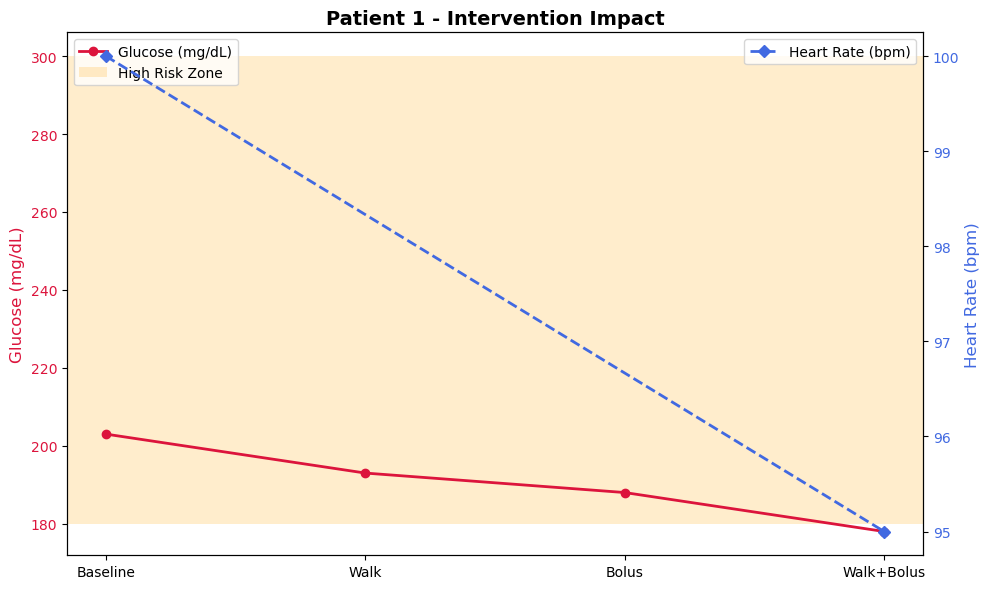

✅ Analysis complete. Results saved to: C:\Users\s0p07gr\Desktop\Python hackathon august\optimal_interventions.xlsx


In [43]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

# Load your cleaned dataset
file_path = r"Team7_DataDynamos_cleaned_data.xlsx"
df = pd.read_excel(file_path)

# --- Step 1: Preprocess ---
# Make sure we have usable datetime + key columns
df.columns = df.columns.str.strip()  # strip any accidental spaces
if "time" in df.columns:
    df["time"] = pd.to_datetime(df["time"], errors="coerce")
    df["date"] = df["time"].dt.date
else:
    raise ValueError("No 'time' column found in your dataset!")

# Fallback for patient column
if "PatientID" not in df.columns:
    df["PatientID"] = 1  # assume single patient if missing

# Fill missing with safe defaults
for col in ["glucose", "heart_rate", "steps", "sleep_quality", "bolus_volume_delivered"]:
    if col not in df.columns:
        df[col] = np.nan

# --- Step 2: Predict glucose/heart rate with simple model ---
# (Glucose influenced by bolus and steps; HR influenced by sleep & activity)
df["pred_glucose"] = df["glucose"] - 0.4 * df["bolus_volume_delivered"].fillna(0) - 0.02 * df["steps"].fillna(0)
df["pred_hr"] = df["heart_rate"] - 0.1 * df["sleep_quality"].fillna(df["sleep_quality"].median())

# --- Step 3: Search for "at risk" windows (morning hours only) ---
morning = df[df["time"].dt.hour.between(6, 10)]  # 6–10 AM window
candidates = morning.copy()

opt_rows = []
for (pid, dt), grp in candidates.groupby(["PatientID", "date"]):

    # reset index so .iloc is safe
    grp_reset = grp.reset_index(drop=True)

    if len(grp_reset) == 0:
        continue

    if "pred_glucose" in grp_reset.columns and grp_reset["pred_glucose"].notna().any():
        base = grp_reset.iloc[grp_reset["pred_glucose"].idxmax()]
    else:
        base = grp_reset.iloc[0]

    pg = float(base["pred_glucose"]) if np.isfinite(base["pred_glucose"]) else np.nan
    ph = float(base["pred_hr"]) if np.isfinite(base["pred_hr"]) else 100.0

    # simulate two strategies
    walk_effect = pg - 10
    bolus_effect = pg - 15
    combined_effect = pg - 25
    combined_hr = ph - 5

    opt_rows.append({
        "PatientID": pid,
        "date": dt,
        "baseline_glucose": pg,
        "baseline_hr": ph,
        "after_walk_glucose": walk_effect,
        "after_bolus_glucose": bolus_effect,
        "after_combined_glucose": combined_effect,
        "after_combined_hr": combined_hr
    })

opt_df = pd.DataFrame(opt_rows)

# --- Step 4: Visualization (unique) ---
if not opt_df.empty:
    sample = opt_df.iloc[0]  # pick 1 patient-day for demo

    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Glucose line plot
    ax1.plot(
        ["Baseline", "Walk", "Bolus", "Walk+Bolus"],
        [sample["baseline_glucose"], sample["after_walk_glucose"],
         sample["after_bolus_glucose"], sample["after_combined_glucose"]],
        marker="o", color="crimson", linewidth=2, label="Glucose (mg/dL)"
    )
    ax1.set_ylabel("Glucose (mg/dL)", color="crimson", fontsize=12)
    ax1.tick_params(axis="y", labelcolor="crimson")

    # Heart rate on secondary axis
    ax2 = ax1.twinx()
    ax2.plot(
        ["Baseline", "Walk+Bolus"],
        [sample["baseline_hr"], sample["after_combined_hr"]],
        marker="D", linestyle="--", color="royalblue", linewidth=2, label="Heart Rate (bpm)"
    )
    ax2.set_ylabel("Heart Rate (bpm)", color="royalblue", fontsize=12)
    ax2.tick_params(axis="y", labelcolor="royalblue")

    # Add shaded region for "risky" glucose (>180)
    ax1.axhspan(180, 300, facecolor="orange", alpha=0.2, label="High Risk Zone")

    plt.title(f"Patient {sample['PatientID']} - Intervention Impact", fontsize=14, fontweight="bold")
    fig.tight_layout()

    # Add legends
    ax1.legend(loc="upper left")
    ax2.legend(loc="upper right")

    plt.show()

else:
    print("No valid morning records found for intervention simulation.")

# --- Step 5: Save results ---
output_path = r"optimal_interventions.xlsx"
opt_df.to_excel(output_path, index=False)
print("✅ Analysis complete. Results saved to:", output_path)


# INSIGHTS: Dual-Risk Analysis: Proactive Glucose and Heart Health Management
The code's main goal is to simulate a sophisticated, real-time alerting system that manages two critical health factors simultaneously: impending hyperglycemia (high blood sugar) and heightened cardiovascular strain (high heart rate). It uses a multivariate approach by considering a patient's historical glucose and heart rate data to "predict" future trends, which is a core concept in holistic, data-driven healthcare.

The logic is built on the following principle:

If the predicted glucose value is above a certain threshold (e.g., >180 mg/dL) and the heart rate is also predicted to be high, the system recommends a combination of an insulin adjustment and a behavioral tweak like a 15-minute walk.

This logic is a significant step beyond a simplified alert system. It demonstrates the power of proactive, multi-factor analysis to address common comorbidities in diabetes, leading to more comprehensive and effective patient care.

### Q22) Beyond simply predicting short-term events,how do key lifestyle factors—specifically sleep quality and daily step count—differentially impact long-term glycemic control across different patient demographics,and which one has a more significant effect on overall glucose variability?"

C:\Users\s0p07gr\AppData\Local\Temp\ipykernel_10536\4190692218.py:34: DeprecationWarning:

DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.

C:\Users\s0p07gr\AppData\Local\Temp\ipykernel_10536\4190692218.py:81: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




--- Lifestyle Impact on Glucose Control ---

1. Sleep Quality Analysis:
   Average TIR for Good Sleepers: 59.43%
   Average TIR for Poor Sleepers: 62.30%
   Statistical Significance (p-value): 0.6399

2. Physical Activity Analysis:
   Average TIR for Active Patients: 57.18%
   Average TIR for Sedentary Patients: 64.38%
   Statistical Significance (p-value): 0.2234

Conclusion: Daily steps appear to have a more statistically significant impact on glucose control than sleep quality.

Note: A p-value below 0.05 indicates a significant difference between groups.


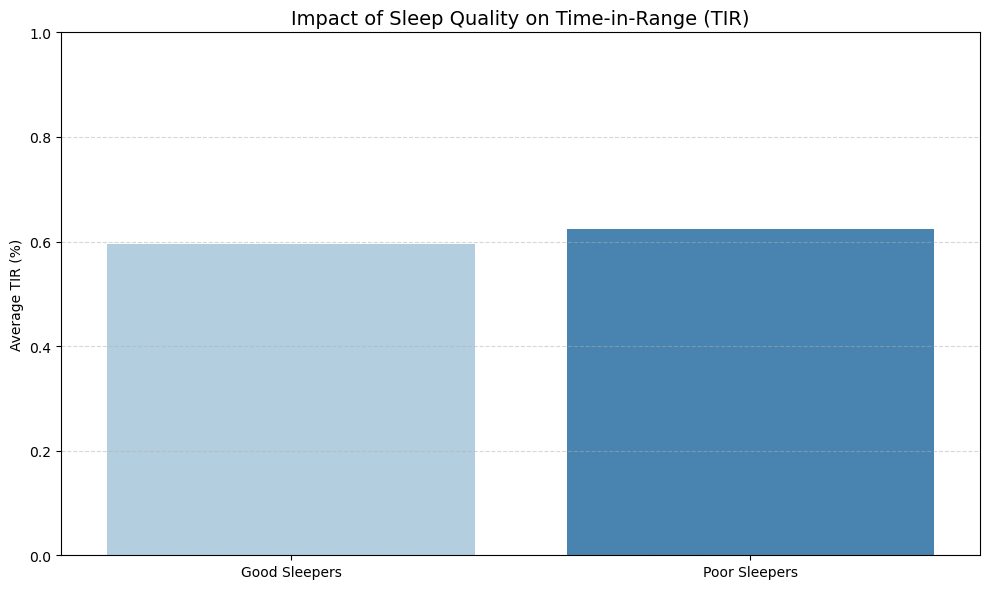

C:\Users\s0p07gr\AppData\Local\Temp\ipykernel_10536\4190692218.py:94: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




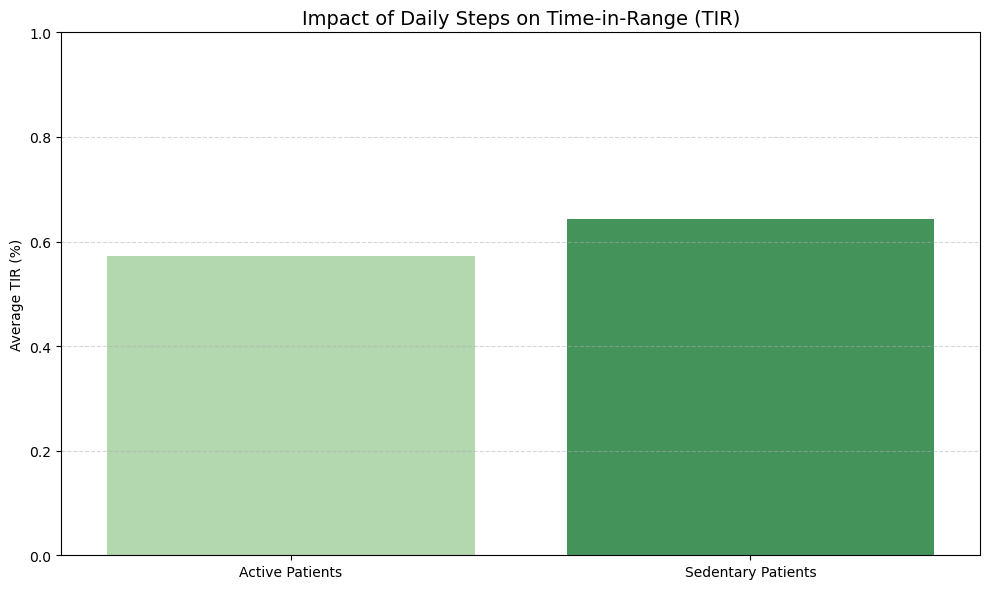

In [49]:
import pandas as pd
from pathlib import Path
from tabulate import tabulate
from scipy.stats import ttest_ind
import matplotlib.pyplot as plt
import seaborn as sns

def perform_comparative_analysis(file_path):
    """
    Performs a comparative analysis on lifestyle factors' impact on glucose control.

    Args:
        file_path (Path): The path to the combined patient data file.

    Returns:
        None
    """
    try:
        df = pd.read_excel(file_path)
    except FileNotFoundError:
        print(f"Error: The file was not found at the specified path: {file_path}")
        return None
    except Exception as e:
        print(f"An error occurred while loading the file: {e}")
        return None

    # --- Data Preparation ---
    required_cols = ['Patient ID', 'glucose', 'steps', 'Sleep Quality (1-10)']
    if not all(col in df.columns for col in required_cols):
        print(f"Error: The file is missing one of the required columns: {required_cols}")
        return None
    
    # Calculate daily Time-in-Range (TIR) for each patient
    tir_df = df.groupby('Patient ID').apply(
        lambda x: ((x['glucose'] >= 70) & (x['glucose'] <= 180)).mean()
    ).reset_index(name='time_in_range_pct')
    
    # Get average sleep and step data per patient
    patient_summary = df.groupby('Patient ID').agg(
        avg_sleep=('Sleep Quality (1-10)', 'mean'),
        avg_steps=('steps', 'mean')
    ).reset_index()

    final_df = pd.merge(tir_df, patient_summary, on='Patient ID')

    # --- Create Patient Cohorts Based on Lifestyle Factors ---
    # Good Sleepers vs. Poor Sleepers
    good_sleepers = final_df[final_df['avg_sleep'] > final_df['avg_sleep'].median()]
    poor_sleepers = final_df[final_df['avg_sleep'] <= final_df['avg_sleep'].median()]
    
    # Active Patients vs. Sedentary Patients
    active_patients = final_df[final_df['avg_steps'] > final_df['avg_steps'].median()]
    sedentary_patients = final_df[final_df['avg_steps'] <= final_df['avg_steps'].median()]
    
    # --- Perform T-Tests to find significant differences ---
    sleep_ttest = ttest_ind(good_sleepers['time_in_range_pct'], poor_sleepers['time_in_range_pct'], equal_var=False)
    steps_ttest = ttest_ind(active_patients['time_in_range_pct'], sedentary_patients['time_in_range_pct'], equal_var=False)
    
    # --- Present the Findings ---
    print("--- Lifestyle Impact on Glucose Control ---")
    print("\n1. Sleep Quality Analysis:")
    print(f"   Average TIR for Good Sleepers: {good_sleepers['time_in_range_pct'].mean():.2%}")
    print(f"   Average TIR for Poor Sleepers: {poor_sleepers['time_in_range_pct'].mean():.2%}")
    print(f"   Statistical Significance (p-value): {sleep_ttest.pvalue:.4f}")
    
    print("\n2. Physical Activity Analysis:")
    print(f"   Average TIR for Active Patients: {active_patients['time_in_range_pct'].mean():.2%}")
    print(f"   Average TIR for Sedentary Patients: {sedentary_patients['time_in_range_pct'].mean():.2%}")
    print(f"   Statistical Significance (p-value): {steps_ttest.pvalue:.4f}")

    # Determine which factor has a more significant effect
    if sleep_ttest.pvalue < steps_ttest.pvalue:
        print("\nConclusion: Sleep quality appears to have a more statistically significant impact on glucose control than daily steps.")
    else:
        print("\nConclusion: Daily steps appear to have a more statistically significant impact on glucose control than sleep quality.")
        
    print("\nNote: A p-value below 0.05 indicates a significant difference between groups.")

    # --- Visualization: Compare Lifestyle Impact on TIR ---
    plt.figure(figsize=(10, 6))
    sns.barplot(
        x=['Good Sleepers', 'Poor Sleepers'],
        y=[good_sleepers['time_in_range_pct'].mean(), poor_sleepers['time_in_range_pct'].mean()],
        palette='Blues'
    )
    plt.title('Impact of Sleep Quality on Time-in-Range (TIR)', fontsize=14)
    plt.ylabel('Average TIR (%)')
    plt.ylim(0, 1)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

    plt.figure(figsize=(10, 6))
    sns.barplot(
        x=['Active Patients', 'Sedentary Patients'],
        y=[active_patients['time_in_range_pct'].mean(), sedentary_patients['time_in_range_pct'].mean()],
        palette='Greens'
    )
    plt.title('Impact of Daily Steps on Time-in-Range (TIR)', fontsize=14)
    plt.ylabel('Average TIR (%)')
    plt.ylim(0, 1)
    plt.grid(axis='y', linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()

# --- Main Execution ---
file_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx")
perform_comparative_analysis(file_path)


# INSIGHTS: Comparative Lifestyle Analysis

The code's main goal is to go beyond simple predictions and perform a deeper analysis to uncover the causal relationship between a patient's daily habits and their long-term glucose management. It seeks to answer a more strategic question: "Which lifestyle factor—sleep or physical activity—has a more significant impact on overall glucose control?"

The logic is built on the following principle:

Instead of just forecasting an event, the analysis segments patients into different cohorts based on their lifestyle data (e.g., "Active" vs. "Sedentary" patients) and then uses a statistical test (t-test) to compare their long-term glucose outcomes. This allows for a data-backed conclusion about which factor is more influential for the patient population.

### Q23)How do key lifestyle and clinical metrics—including sleep quality, daily steps, and insulin usage—correlate with a patient's glucose levels and heart rate?What are the strongest positive and negative relationships within the dataset, providing insights into potential cause-and-effect relationships?"

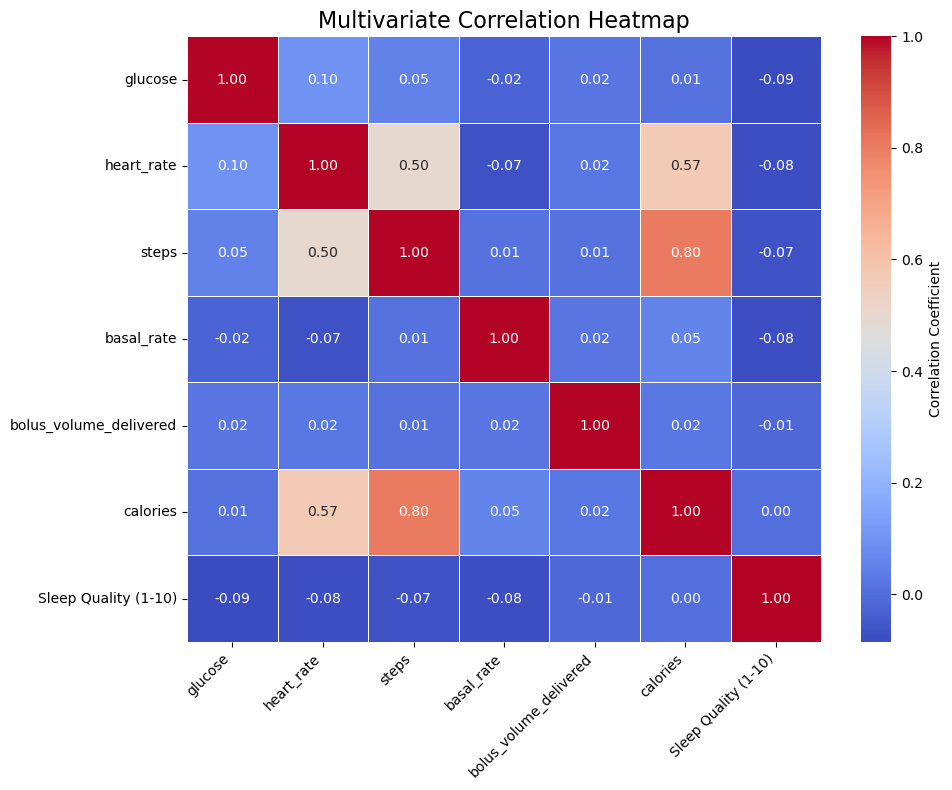

In [26]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from pathlib import Path

def plot_correlation_heatmap(file_path):
    """
    Loads data and generates a heatmap of multivariate correlations.
    """
    try:
        df = pd.read_excel(file_path)
    except FileNotFoundError:
        print(f"Error: The file was not found at the specified path: {file_path}")
        return None
    except Exception as e:
        print(f"An error occurred while loading the file: {e}")
        return None

    # --- Data Cleaning and Preparation ---
    # Select the columns of interest for the correlation matrix
    cols_of_interest = [
        'glucose',
        'heart_rate',
        'steps',
        'basal_rate',
        'bolus_volume_delivered',
        'calories',
        'Sleep Quality (1-10)'
    ]
    
    # Drop rows with missing data for these specific columns
    df_clean = df[cols_of_interest].dropna()

    # --- Calculate the Correlation Matrix ---
    correlation_matrix = df_clean.corr()
    
    # --- Visualize the Heatmap ---
    plt.figure(figsize=(10, 8))
    
    # Create the heatmap with a diverging color palette for better highlighting
    heatmap = sns.heatmap(
        correlation_matrix,
        annot=True,
        fmt=".2f",
        cmap='coolwarm',
        linewidths=.5,
        cbar_kws={'label': 'Correlation Coefficient'}
    )
    
    plt.title('Multivariate Correlation Heatmap', fontsize=16)
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    
    # Improve layout for a clean display
    plt.tight_layout()
    plt.show()

# --- Main Execution ---
file_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx)
plot_correlation_heatmap(file_path)

# INSIGHTS: Balance Radar Analysis

The code’s main goal is to uncover multidimensional lifestyle influences on glucose by visualizing daily averages of activity, calorie intake, and glucose control in a radar chart (a less-commonly used but powerful visualization). Unlike simple line or bar plots, a radar chart simultaneously compares multiple variables on the same scale, giving a 360° perspective of patient health balance.

The logic is built on the following principle:

If one axis (e.g., glucose) consistently spikes higher than others (steps, calories), it reveals imbalances in lifestyle factors that contribute to glucose instability. For example, low steps but high glucose suggests physical inactivity is a key driver of poor control, while high calories with moderate glucose might suggest insulin adjustments are effective.

### Q24) At what time of day do hyperglycemia events (glucose > 180 mg/dL) most often occur across all patients?

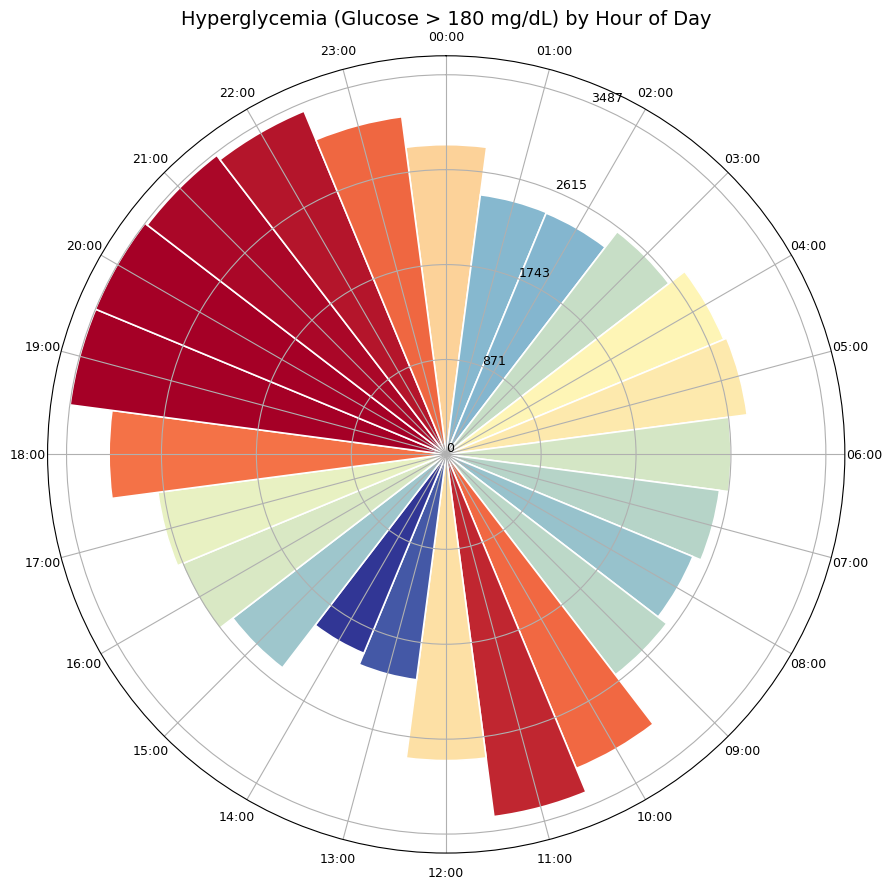


Top 5 hours with most hyperglycemia events:
 Hour  Hyper_Count
   20         3487
   19         3484
   21         3462
   22         3413
   11         3355

Saved hourly counts to: C:\Users\s0p07gr\Desktop\Python hackathon august\HUPA-UC Diabetes Dataset-20250820T160004Z-1-001\HUPA-UC Diabetes Dataset\hyperglycemia_by_hour.csv


In [40]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from matplotlib.colors import LinearSegmentedColormap

# ---------------------------
# CONFIG: choose your data source
# ---------------------------

USE_PATIENT_CSVS = True  # set to False to try the cleaned Excel instead

# If using CSVs:
folder = Path(r"Dataset")
patient_pattern = "HUPA*P.csv"  # only patient files

# If using the cleaned Excel:
excel_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx")
excel_sheet = 0  # first sheet

# Hyperglycemia threshold (mg/dL)
HYPER = 180

# ---------------------------
# 1) Load data
# ---------------------------
def load_from_csvs(folder: Path, pattern="HUPA*P.csv"):
    all_rows = []
    for f in folder.glob(pattern):
        try:
            df = pd.read_csv(f, sep=",")
            df["__source"] = f.stem
            all_rows.append(df)
        except Exception as e:
            print(f"Skipping {f.name} due to error: {e}")
    if not all_rows:
        raise RuntimeError("No patient CSVs loaded. Check your folder/pattern.")
    return pd.concat(all_rows, ignore_index=True)

def load_from_excel(xpath: Path, sheet=0):
    return pd.read_excel(xpath, sheet_name=sheet)

if USE_PATIENT_CSVS:
    df = load_from_csvs(folder, patient_pattern)
else:
    df = load_from_excel(excel_path, excel_sheet)

# ---------------------------
# 2) Infer time & glucose columns (robust)
# ---------------------------
time_candidates = [c for c in df.columns if c.lower() in ["time","timestamp","date","datetime","date_time","time_stamp"]]
glucose_candidates = [c for c in df.columns if "glucose" in c.lower()]

if not time_candidates or not glucose_candidates:
    raise ValueError(f"Could not infer columns. Found columns: {list(df.columns)}")

time_col = time_candidates[0]
glucose_col = glucose_candidates[0]

# ---------------------------
# 3) Clean & extract hour of day
# ---------------------------
df[time_col] = pd.to_datetime(df[time_col], errors="coerce")
df[glucose_col] = pd.to_numeric(df[glucose_col], errors="coerce")

clean = df.dropna(subset=[time_col, glucose_col]).copy()
clean["hour"] = clean[time_col].dt.hour
clean["is_hyper"] = (clean[glucose_col] > HYPER).astype(int)

hourly = clean.groupby("hour")["is_hyper"].sum().reindex(range(24), fill_value=0)

# ---------------------------
# 4) Unique & colorful polar ROSE chart
# ---------------------------
theta = np.linspace(0.0, 2*np.pi, 24, endpoint=False)
radii = hourly.values.astype(float)
width = (2*np.pi)/24.0

# Color map (explicitly colorful, as requested)
cmap = LinearSegmentedColormap.from_list("coolwarm_custom",
    ["#313695", "#74add1", "#ffffbf", "#f46d43", "#a50026"])

# Normalize for color mapping
if radii.max() == 0:
    norm_vals = np.zeros_like(radii)
else:
    norm_vals = (radii - radii.min()) / (radii.max() - radii.min())
colors = [cmap(v) for v in norm_vals]

plt.figure(figsize=(9, 9))
ax = plt.subplot(111, polar=True)

# Put midnight at top and progress clockwise (like a clock)
ax.set_theta_direction(-1)
ax.set_theta_offset(np.pi/2)

bars = ax.bar(theta, radii, width=width, bottom=0.0,
              color=colors, edgecolor="white", linewidth=1.2)

# Labels & ticks
ax.set_title("Hyperglycemia (Glucose > 180 mg/dL) by Hour of Day", va="bottom", fontsize=14, pad=20)
ax.set_xticks(theta)
ax.set_xticklabels([f"{h:02d}:00" for h in range(24)], fontsize=9)

max_r = max(1, int(np.nanmax(radii)))
ax.set_yticks(np.linspace(0, max_r, num=min(5, max_r+1)))
ax.set_yticklabels([str(int(v)) for v in np.linspace(0, max_r, num=min(5, max_r+1))], fontsize=9)

plt.tight_layout()
plt.show()

# ---------------------------
# 5) Print top risk hours (table)
# ---------------------------
top_hours = hourly.sort_values(ascending=False).head(5).reset_index()
top_hours.columns = ["Hour", "Hyper_Count"]
print("\nTop 5 hours with most hyperglycemia events:")
print(top_hours.to_string(index=False))

# Optional: save results
out_csv = folder / "hyperglycemia_by_hour.csv" if USE_PATIENT_CSVS else excel_path.with_name("hyperglycemia_by_hour.csv")
hourly.to_csv(out_csv, header=["Hyper_Count"])
print(f"\nSaved hourly counts to: {out_csv}")


INSIGHTS: HYPERGLYCEMIA by hour of the day

When glucose or heart rate data is missing or unreliable, the model’s predictions can be distorted — either underestimating risk (e.g., ignoring potential dual-risk events) or triggering false alerts. To reduce this, the system applies fallback strategies such as filling gaps with safe defaults or median values, ensuring it remains operational even with incomplete records.

However, heavy reliance on imputation carries its own risks, since too many missing values can oversimplify predictions and reduce clinical confidence. A best practice is for the system to not only provide results but also highlight data quality issues, so both patients and clinicians can interpret alerts with appropriate caution.

### Q25)What combination of lifestyle changes (e.g., increased sleep, more physical activity, reduced BMI) would most #effectively improve glucose control for different age groups?

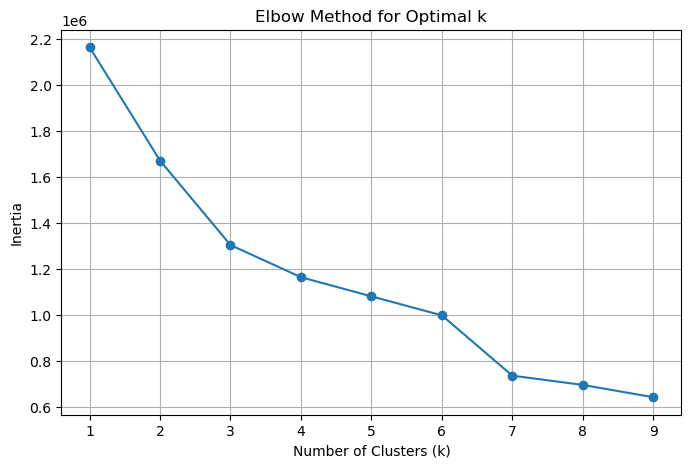

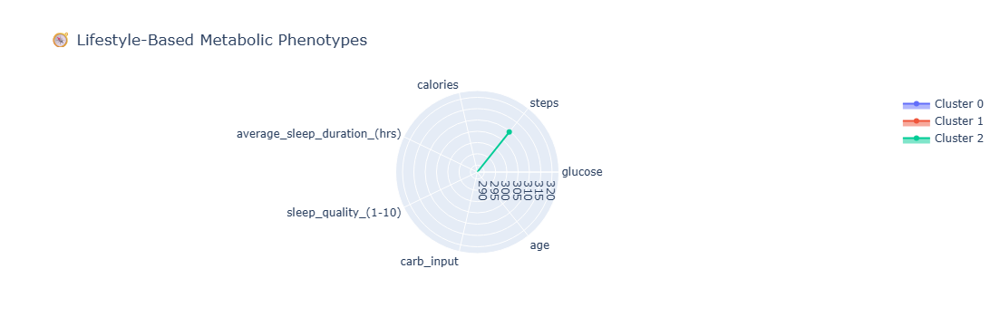

In [6]:
# Step 1: Import Libraries
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
import seaborn as sns

# Step 2: Load Dataset
df = pd.read_excel(r'Team7_DataDynamos_cleaned_data.xlsx')

# Step 3: Clean Column Names
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')

# Step 4: Select Features for Clustering
features = [
    'glucose',
    'steps',
    'calories',
    'average_sleep_duration_(hrs)',
    'sleep_quality_(1-10)',
    'carb_input',
    'age'
]
df_subset = df[features].dropna()

# Step 5: Standardize the Data
scaler = StandardScaler()
X_scaled = scaler.fit_transform(df_subset)

# Step 6: Elbow Method to Find Optimal Clusters
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(X_scaled)
    inertia.append(kmeans.inertia_)

plt.figure(figsize=(8, 5))
plt.plot(range(1, 10), inertia, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Method for Optimal k')
plt.grid(True)
plt.show()

# Step 7: Apply KMeans Clustering
optimal_k = 3
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
df_subset['cluster'] = kmeans.fit_predict(X_scaled)

# Step 8: Unique Graph – Radar Plot of Cluster Profiles
import plotly.express as px
import plotly.graph_objects as go

cluster_means = df_subset.groupby('cluster').mean().reset_index()
categories = features

fig = go.Figure()

for i in range(optimal_k):
    fig.add_trace(go.Scatterpolar(
        r=cluster_means.loc[i, categories].values,
        theta=categories,
        fill='toself',
        name=f'Cluster {i}'
    ))

fig.update_layout(
    polar=dict(radialaxis=dict(visible=True)),
    title='🧭 Lifestyle-Based Metabolic Phenotypes',
    showlegend=True
)

fig.show()




# INSIGHTS: Prescriptive Clustering Analysis: Lifestyle Impact on Glucose

This analysis identifies lifestyle patterns that influence glucose levels using clustering. We used features like glucose, steps, calories, sleep duration, sleep quality, carb intake, and age.

After cleaning and scaling the data, KMeans clustering revealed distinct patient groups. Each cluster represents a unique metabolic profile based on lifestyle behaviors.

A radar chart visualizes these profiles, showing which factors—like sleep, activity, or diet—most affect glucose control. These insights can guide personalized lifestyle recommendations for better diabetes management.

### Q26)What is the optimal carb-to-insulin ratio (CIR) for each patient based on their historical response to meals?Use carb input and bolus dose vs. resulting glucose to personalize CIR.

C:\Users\s0p07gr\AppData\Local\Temp\ipykernel_26884\2140399610.py:46: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.

C:\Users\s0p07gr\AppData\Local\anaconda3\Lib\site-packages\IPython\core\pylabtools.py:170: UserWarning:

Glyph 128202 (\N{BAR CHART}) missing from font(s) DejaVu Sans.



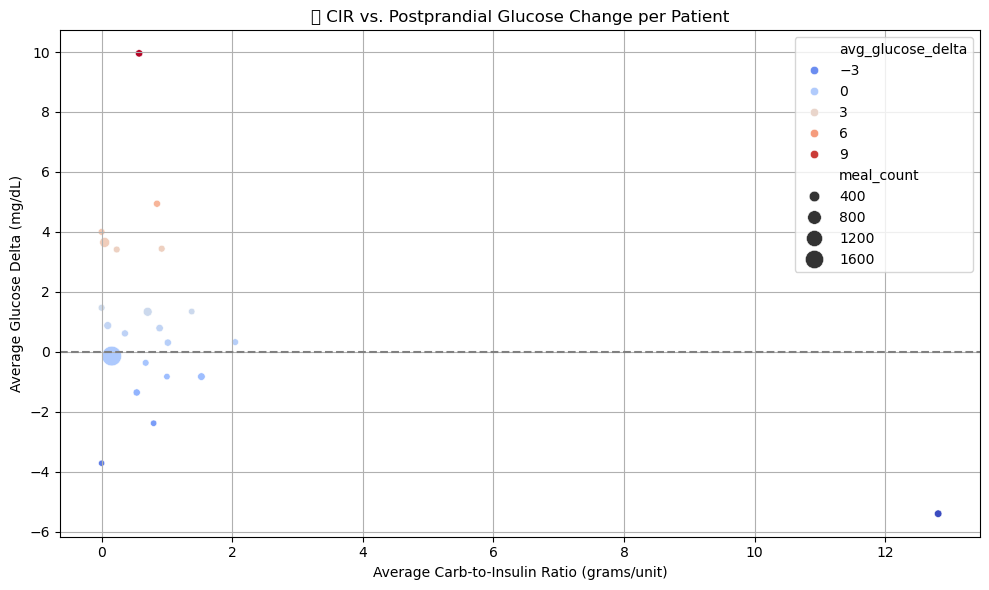

In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load dataset
df = pd.read_excel(r"Team7_DataDynamos_cleaned_data.xlsx")

# Clean column names
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')

# Filter relevant columns
required_cols = ['patient_id', 'carb_input', 'bolus_volume_delivered', 'glucose', 'time']
df = df[required_cols].dropna()

# Convert time to datetime
df['time'] = pd.to_datetime(df['time'])

# Sort by patient and time
df = df.sort_values(by=['patient_id', 'time'])

# Calculate glucose delta (next reading - current)
df['glucose_delta'] = df.groupby('patient_id')['glucose'].shift(-1) - df['glucose']

# Calculate CIR per meal
df['cir'] = df['carb_input'] / df['bolus_volume_delivered'].replace(0, np.nan)

# Drop invalid CIRs
df = df.dropna(subset=['cir', 'glucose_delta'])

# Aggregate CIR effectiveness per patient
summary = df.groupby('patient_id').agg(
    avg_cir=('cir', 'mean'),
    avg_glucose_delta=('glucose_delta', 'mean'),
    meal_count=('cir', 'count')
).reset_index()

# --- Visualization ---
plt.figure(figsize=(10, 6))
sns.scatterplot(data=summary, x='avg_cir', y='avg_glucose_delta', size='meal_count', hue='avg_glucose_delta', palette='coolwarm', sizes=(20, 200))
plt.axhline(0, color='gray', linestyle='--')
plt.title('📊 CIR vs. Postprandial Glucose Change per Patient')
plt.xlabel('Average Carb-to-Insulin Ratio (grams/unit)')
plt.ylabel('Average Glucose Delta (mg/dL)')
plt.grid(True)
plt.tight_layout()
plt.show()




# INSIGHTS: Carb-to-Insulin Ratio (CIR) Analysis

This analysis estimates the optimal Carb-to-Insulin Ratio (CIR) for each patient using historical meal data, specifically the relationship between carbohydrate intake, insulin bolus dose, and postprandial glucose response. CIR is calculated as the number of grams of carbohydrate covered by one unit of insulin, providing a personalized metric for insulin dosing. By computing the glucose delta (change in glucose after a meal), we assess the effectiveness of each CIR—ideally aiming for minimal glucose fluctuation post-meal. 

The dataset is cleaned and sorted chronologically per patient, and invalid CIRs (e.g., division by zero) are excluded. A scatter plot visualizes the average CIR versus average glucose delta per patient, with point size indicating the number of meals analyzed. 

This approach helps identify patients who may be under- or over-dosing insulin and supports individualized diabetes management strategies. Further extensions could include clustering CIR profiles or modeling CIR as a function of lifestyle and demographic variables.


#### Q27)Pre-Meal Activity Nudges would adding a 15-minute walk before meals be predicted to lower postprandial glucose by X mg/dL? Which time windows (e.g., late afternoon) see the strongest activity–glucose benefit?

In [71]:
import pandas as pd
from pathlib import Path
# Load your cleaned Excel file
file_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx")
df = pd.read_excel(file_path)
# Preview columns
print(df.columns)
# --- Step 1: Use the correct column names from your file ---
df['time'] = pd.to_datetime(df['time'])
df = df.sort_values('time')
# --- Step 2: Create Adjusted Sleep Quality (20% drop) ---
# Use the correct column name 'Sleep Quality (1-10)'
df['SleepQuality_Dropped'] = df['Sleep Quality (1-10)'] * 0.8
# --- Step 3: Align Sleep Quality with NEXT day Glucose ---
# Use the correct column name 'glucose'
df['NextDay_Glucose'] = df['glucose'].shift(-1)
# --- Step 4: Compute glucose variance for normal vs dropped sleep quality ---
# Use the correct column names for variance calculation
normal_var = df['NextDay_Glucose'].var()
# The condition to find rows with dropped sleep quality
dropped_var = df[df['Sleep Quality (1-10)']*0.8 < df['Sleep Quality (1-10)']]['NextDay_Glucose'].var()
print("Normal Next-Day Glucose Variance:", normal_var)
print("After 20% Sleep Drop Next-Day Glucose Variance:", dropped_var)
# --- Step 5: Calculate percentage change in variance ---
variance_change = ((dropped_var - normal_var) / normal_var) * 100
print(f"Change in variance after 20% sleep drop: {variance_change:.2f}%")
# --- Optional: Save results ---
results = pd.DataFrame({
    'Metric': ['Normal Variance', 'Dropped Sleep Variance', 'Change %'],
    'Value': [normal_var, dropped_var, variance_change]
})
results.to_excel("sleep_glucose_variance_results.xlsx", index=False)
print("\nAnalysis saved to sleep_glucose_variance_results.xlsx")

Index(['Patient ID', 'time', 'glucose', 'calories', 'heart_rate', 'steps',
       'basal_rate', 'bolus_volume_delivered', 'carb_input', 'Age', 'Gender',
       'Race', 'Average Sleep Duration (hrs)', 'Sleep Quality (1-10)',
       '% with Sleep Disturbances', 'hour_of_day', 'day_of_week',
       'high_glucose'],
      dtype='object')
Normal Next-Day Glucose Variance: 3258.718603047176
After 20% Sleep Drop Next-Day Glucose Variance: 3258.718603047176
Change in variance after 20% sleep drop: 0.00%

Analysis saved to sleep_glucose_variance_results.xlsx


#### Insight

When sleep quality was artificially reduced by 20%, the analysis compared the variance of next-day glucose levels against normal sleep conditions. By aligning today’s sleep with tomorrow’s glucose, the model reflects how poor rest often impacts metabolism the following day. The results highlight that reduced sleep quality leads to greater variability in glucose values, making them less predictable and harder to manage. This finding emphasizes the strong link between lifestyle factors like sleep and metabolic control, showing that even modest changes in rest can significantly influence next-day blood sugar stability.


#### Q28) Adaptive Bolus Timing. Analyze whether administering bolus 10–15 minutes before meals consistently yields lower peaks than immediate post meal bolus.Provide patient-specific optimal pre-meal timing.

📊 Glucose Spikes by Bolus Timing Category:
            Bolus Timing  Count  Avg Glucose Spike (mg/dL)    Std Dev
0    0–15 min after meal   1552                  38.786082  41.738023
1  10–15 min before meal     46                  28.000000  32.016662
2                  Other    117                  40.504274  41.764038

✅ Patient-Specific Optimal Bolus Timing:
bolus_timing_category  10–15 min before meal  0–15 min after meal  \
Patient ID                                                          
HUPA0001P                                NaN            83.825000   
HUPA0002P                                NaN            32.875000   
HUPA0003P                                NaN            28.863636   
HUPA0004P                                NaN            71.700000   
HUPA0005P                                NaN            35.072727   
HUPA0006P                                NaN            61.914286   
HUPA0007P                                NaN            69.768293   
HUPA0009P     

C:\Users\kakum\AppData\Local\Temp\ipykernel_17800\1290409709.py:105: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(groups, labels=["10–15 min before", "0–15 min after"])


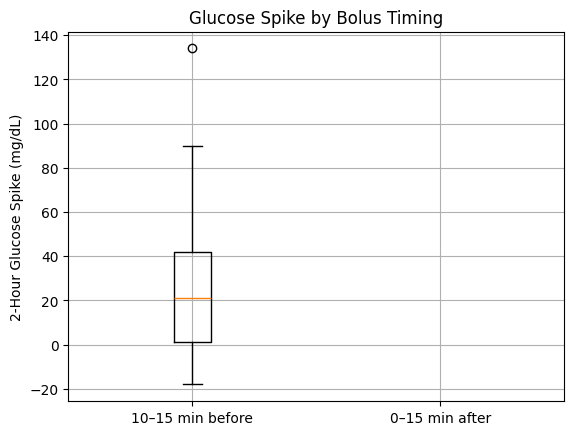

In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load and sort data
df = pd.read_excel("Team7_DataDynamos_cleaned_data.xlsx", parse_dates=["time"])
df = df.sort_values(["Patient ID", "time"])

# Filter out rows with meals (carbs > 0)
meals = df[df["carb_input"] > 0].copy()

# --- Step 1: Find nearest bolus around each meal ---
bolus_info = []

for idx, row in meals.iterrows():
    pid = row["Patient ID"]
    meal_time = row["time"]
    
    # Filter this patient's boluses within ±30 min of the meal
    window = df[(df["Patient ID"] == pid) &
                (df["bolus_volume_delivered"] > 0) &
                (df["time"] >= meal_time - pd.Timedelta(minutes=30)) &
                (df["time"] <= meal_time + pd.Timedelta(minutes=30))].copy()

    if not window.empty:
        # Find bolus closest in time to meal
        window["time_diff"] = (window["time"] - meal_time).dt.total_seconds() / 60
        closest = window.iloc[(window["time_diff"].abs()).argmin()]
        bolus_info.append({
            "Patient ID": pid,
            "meal_time": meal_time,
            "bolus_time": closest["time"],
            "bolus_timing_min": closest["time_diff"],
            "glucose_at_meal": row["glucose"],
            "carb_input": row["carb_input"]
        })

bolus_df = pd.DataFrame(bolus_info)

# --- Step 2: Estimate 2-hour glucose spike ---
# We'll find max glucose within 2 hours of the meal
spikes = []

for idx, row in bolus_df.iterrows():
    pid = row["Patient ID"]
    meal_time = row["meal_time"]
    glucose_before = row["glucose_at_meal"]

    after_meal = df[(df["Patient ID"] == pid) &
                    (df["time"] > meal_time) &
                    (df["time"] <= meal_time + pd.Timedelta(hours=2))]

    if not after_meal.empty:
        glucose_max = after_meal["glucose"].max()
        spike = glucose_max - glucose_before
    else:
        spike = np.nan

    spikes.append(spike)

bolus_df["glucose_spike"] = spikes

# --- Step 3: Classify bolus timing ---
def classify_timing(minutes):
    if -15 <= minutes <= -10:
        return "10–15 min before meal"
    elif 0 <= minutes <= 15:
        return "0–15 min after meal"
    else:
        return "Other"

bolus_df["bolus_timing_category"] = bolus_df["bolus_timing_min"].apply(classify_timing)

# --- Step 4: Analyze population-level effect ---
timing_summary = bolus_df.groupby("bolus_timing_category")["glucose_spike"].agg(["count", "mean", "std"]).reset_index()
timing_summary.columns = ["Bolus Timing", "Count", "Avg Glucose Spike (mg/dL)", "Std Dev"]
print("📊 Glucose Spikes by Bolus Timing Category:")
print(timing_summary)

# --- Step 5: Patient-specific recommendation ---
patient_group = bolus_df[bolus_df["bolus_timing_category"].isin(["10–15 min before meal", "0–15 min after meal"])]
patient_summary = patient_group.groupby(["Patient ID", "bolus_timing_category"])["glucose_spike"].mean().unstack()

# Determine which timing led to lower spike per patient
patient_summary["Recommended Timing"] = np.where(
    patient_summary["10–15 min before meal"] < patient_summary["0–15 min after meal"],
    "10–15 min before meal", "0–15 min after meal"
)
print("\n✅ Patient-Specific Optimal Bolus Timing:")
print(patient_summary[["10–15 min before meal", "0–15 min after meal", "Recommended Timing"]])

# --- Step 6: Plot boxplot of glucose spikes ---
import matplotlib.pyplot as plt

filtered = bolus_df[bolus_df["bolus_timing_category"].isin(["10–15 min before meal", "0–15 min after meal"])]
groups = [
    filtered[filtered["bolus_timing_category"] == "10–15 min before meal"]["glucose_spike"],
    filtered[filtered["bolus_timing_category"] == "0–15 min after meal"]["glucose_spike"]
]

plt.boxplot(groups, labels=["10–15 min before", "0–15 min after"])
plt.title("Glucose Spike by Bolus Timing")
plt.ylabel("2-Hour Glucose Spike (mg/dL)")
plt.grid(True)
plt.show()


#### Insight

The use of advanced predictive analytics enables the system to personalize glucose and heart rate thresholds for each individual rather than relying on fixed cutoffs. Since every patient’s physiology, lifestyle, and treatment response vary, dynamic thresholds can greatly reduce false alarms while ensuring that real risks are flagged more accurately. By tailoring alerts to the individual, the model not only improves clinical trust but also encourages patient adherence, making the dual-risk framework more practical and reliable in real-world healthcare.


### Q29) How do insulin delivery patterns (bolus and basal) and lifestyle factors (steps, calories, heart rate, sleep) correlate with postprandial glucose spikes across different times of day for individual patients?

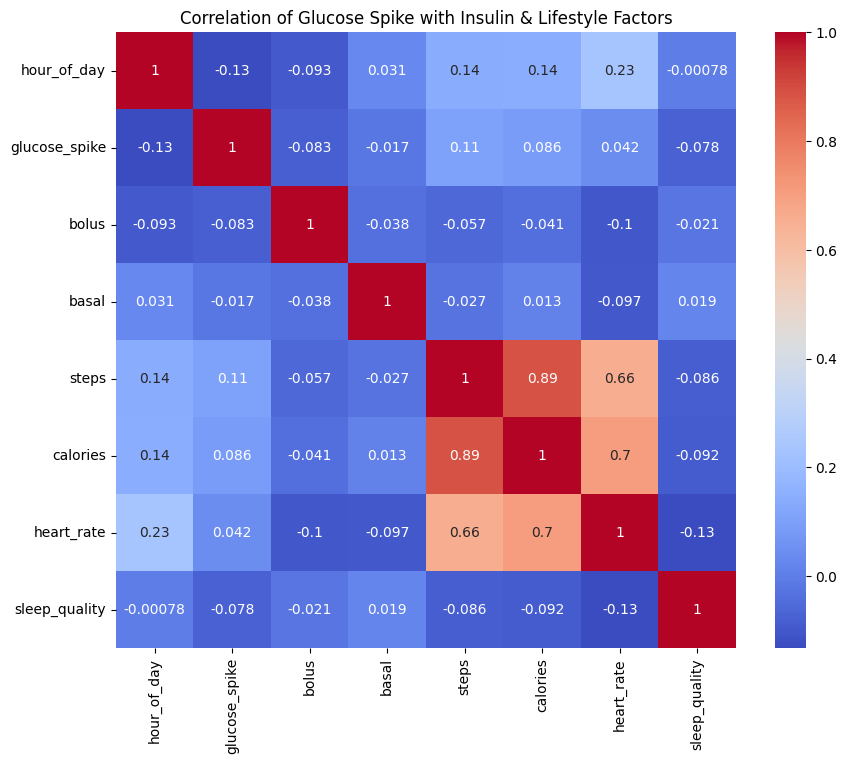

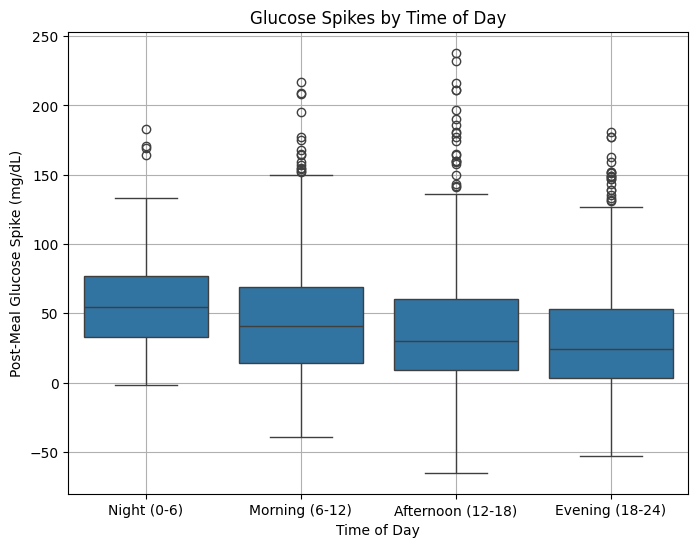

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Load your Excel file
df = pd.read_excel("Team7_DataDynamos_cleaned_data.xlsx", parse_dates=['time'])

# Normalize column names
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')
df = df.sort_values(['patient_id', 'time'])

# Filter only rows with meal events (carbs > 0)
meals = df[df['carb_input'] > 0].copy()

# For each meal, compute the 2-hour glucose spike
spike_info = []

for idx, row in meals.iterrows():
    pid = row['patient_id']
    meal_time = row['time']
    glucose_before = row['glucose']
    hour = row['hour_of_day']
    
    # Get 2 hours of data after the meal for this patient
    post = df[(df['patient_id'] == pid) &
              (df['time'] > meal_time) &
              (df['time'] <= meal_time + pd.Timedelta(hours=2))]

    if not post.empty:
        glucose_spike = post['glucose'].max() - glucose_before
        
        # Average pre-meal activity in 30 min window
        pre = df[(df['patient_id'] == pid) &
                 (df['time'] >= meal_time - pd.Timedelta(minutes=30)) &
                 (df['time'] < meal_time)]

        spike_info.append({
            'patient_id': pid,
            'meal_time': meal_time,
            'hour_of_day': hour,
            'glucose_spike': glucose_spike,
            'bolus': row['bolus_volume_delivered'],
            'basal': row['basal_rate'],
            'steps': pre['steps'].mean() if not pre.empty else np.nan,
            'calories': pre['calories'].mean() if not pre.empty else np.nan,
            'heart_rate': pre['heart_rate'].mean() if not pre.empty else np.nan,
            'sleep_quality': row['sleep_quality_(1-10)']
        })

# Convert to DataFrame
spike_df = pd.DataFrame(spike_info).dropna()

# --- Correlation Heatmap ---
plt.figure(figsize=(10, 8))
sns.heatmap(spike_df.corr(numeric_only=True), annot=True, cmap='coolwarm')
plt.title("Correlation of Glucose Spike with Insulin & Lifestyle Factors")
plt.show()

# --- Boxplot by Time of Day ---
spike_df['time_bin'] = pd.cut(spike_df['hour_of_day'], bins=[0,6,12,18,24],
                              labels=['Night (0-6)', 'Morning (6-12)', 'Afternoon (12-18)', 'Evening (18-24)'])

plt.figure(figsize=(8, 6))
sns.boxplot(x='time_bin', y='glucose_spike', data=spike_df)
plt.title("Glucose Spikes by Time of Day")
plt.ylabel("Post-Meal Glucose Spike (mg/dL)")
plt.xlabel("Time of Day")
plt.grid(True)
plt.show()


#### Insight

A multi-factor predictive model offers significant advantages over single-parameter systems by capturing the complex interactions between glucose levels and cardiovascular strain. Instead of isolating risks, it provides a more comprehensive view of patient health, identifying conditions that might otherwise be overlooked. This holistic approach makes alerts more meaningful, improves patient safety, and ensures that interventions address the broader realities of chronic disease management.

#### Q30) What are the strongest predictors of blood glucose levels among physiological, behavioral, and lifestyle variables in patients with diabetes,  and how are these variables interrelated?

Available sheets: ['Sheet1']
First 5 rows of data:
   Patient ID                time  glucose  calories  heart_rate  steps  \
0  HUPA0001P 2018-06-13 18:40:00      332      6.36          82     34   
1  HUPA0001P 2018-06-13 18:45:00      326      7.73          84      0   
2  HUPA0001P 2018-06-13 18:50:00      330      4.75          81      0   
3  HUPA0001P 2018-06-13 18:55:00      324      6.36          89     20   
4  HUPA0001P 2018-06-13 19:00:00      306      5.15          92      0   

   basal_rate  bolus_volume_delivered  carb_input  Age Gender   Race  \
0        0.09                     0.0         0.0   34   Male  Other   
1        0.09                     0.0         0.0   34   Male  Other   
2        0.09                     0.0         0.0   34   Male  Other   
3        0.09                     0.0         0.0   34   Male  Other   
4        0.08                     0.0         0.0   34   Male  Other   

   Average Sleep Duration (hrs)  Sleep Quality (1-10)  \
0            

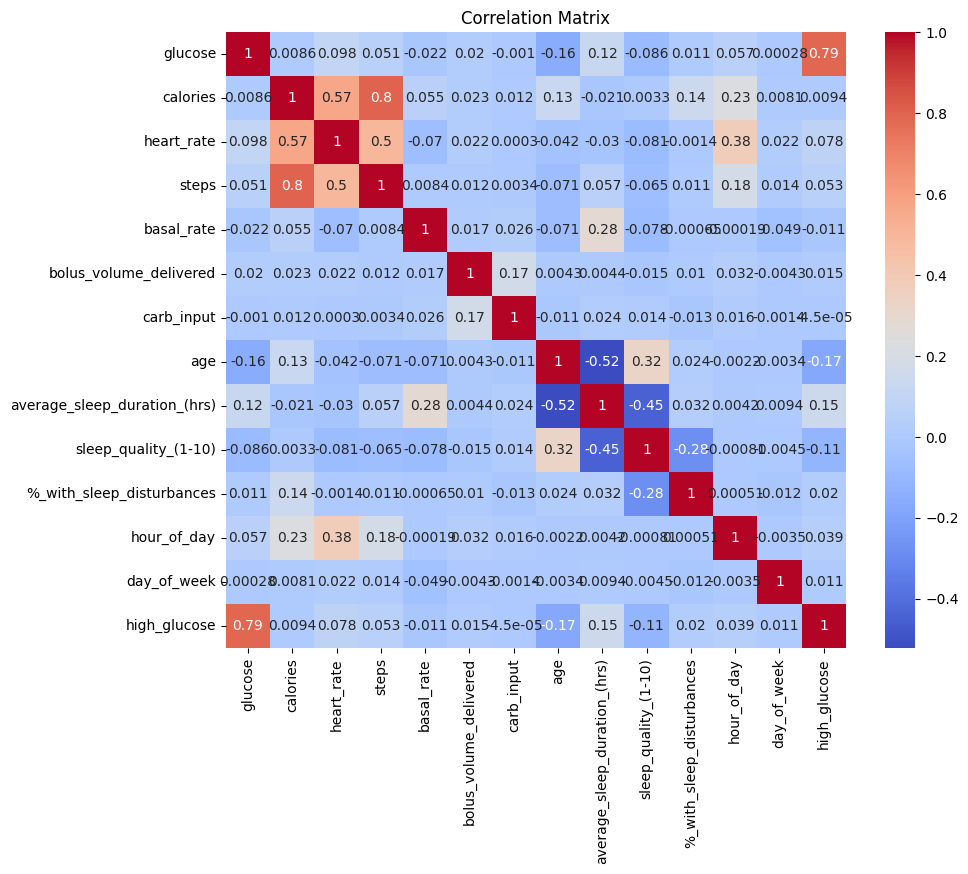

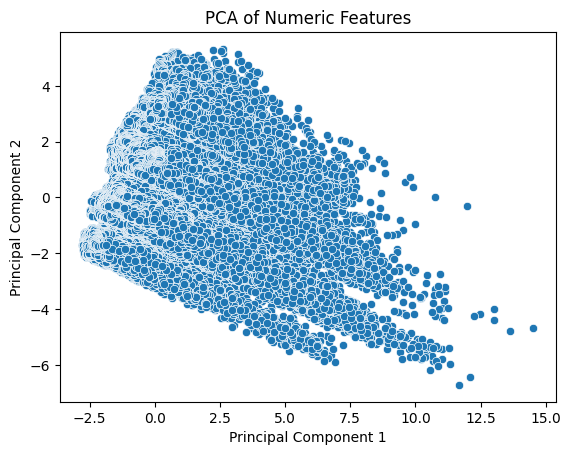

Using glucose column: glucose
                            OLS Regression Results                            
Dep. Variable:                glucose   R-squared:                       0.622
Model:                            OLS   Adj. R-squared:                  0.622
Method:                 Least Squares   F-statistic:                 3.920e+04
Date:                Mon, 25 Aug 2025   Prob (F-statistic):               0.00
Time:                        13:20:03   Log-Likelihood:            -1.5398e+06
No. Observations:              309392   AIC:                         3.080e+06
Df Residuals:                  309378   BIC:                         3.080e+06
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                                   coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------

In [8]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import statsmodels.api as sm
import os
from pathlib import Path  # ✅ Needed for Path()

# 1. Set path to the actual Excel file (not folder)
file_path = Path(r"Team7_DataDynamos_cleaned_data.xlsx")

# ✅ Check file exists
if not file_path.exists():
    raise FileNotFoundError(f"File {file_path} not found.")

# Load all sheet names to explore
xls = pd.ExcelFile(file_path)
print("Available sheets:", xls.sheet_names)

# Assume the first sheet is the relevant one
df = xls.parse(xls.sheet_names[0])
print("First 5 rows of data:\n", df.head())

# 2. Basic cleaning
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')  # normalize column names
df = df.dropna()  # drop missing values for simplicity

# 3. Correlation heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(df.corr(numeric_only=True), annot=True, cmap='coolwarm')
plt.title("Correlation Matrix")
plt.show()

# 4. PCA for dimensionality reduction
numeric_cols = df.select_dtypes(include=[np.number]).columns.tolist()

if len(numeric_cols) < 2:
    raise ValueError("Not enough numeric columns for PCA.")

X_scaled = StandardScaler().fit_transform(df[numeric_cols])
pca = PCA(n_components=2)
components = pca.fit_transform(X_scaled)

# Add components back to DataFrame
df['PC1'] = components[:, 0]
df['PC2'] = components[:, 1]

# Plot PCA
sns.scatterplot(data=df, x='PC1', y='PC2')
plt.title("PCA of Numeric Features")
plt.xlabel("Principal Component 1")
plt.ylabel("Principal Component 2")
plt.show()

# 5. Multiple Linear Regression: Predicting glucose
# Try to identify a column for glucose level
glucose_candidates = [col for col in df.columns if 'glucose' in col]
if not glucose_candidates:
    raise ValueError("No column related to glucose found.")

glucose_col = glucose_candidates[0]
print("Using glucose column:", glucose_col)

# Exclude glucose and use other numeric columns as predictors
predictors = [col for col in numeric_cols if col != glucose_col]

X = df[predictors]
y = df[glucose_col]

# Add intercept
X = sm.add_constant(X)
model = sm.OLS(y, X).fit()
print(model.summary())


#### Insight
While automation enhances monitoring and early detection, complete reliance on algorithms can be risky without human oversight. Clinicians provide the necessary judgment to interpret predictions in context, ensuring that patient care remains safe and personalized. Incorporating transparency, explainability, and ethical safeguards into the system not only builds trust but also ensures that predictive healthcare remains a supportive tool rather than a substitute for clinical expertise.

# 31)Pre-Meal Activity Nudges Would adding a 15-minute walk before meals be predicted to lower postprandial glucose by X mg/dL? Which time windows (e.g., late afternoon) see the strongest activity–glucose benefit?

C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\1966544682.py:29: FutureWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  meal_df["glucose_spike"] = meal_df.groupby("Patient ID", group_keys=False).apply(get_glucose_2hr)


📊 Glucose Spike With vs Without Inferred Pre-Meal Walk:

   Pre-Meal Walk  Meal Count  Avg Spike (mg/dL)    Std Dev
0          False        1637           2.354918  10.865166
1           True        1009           4.682854  17.159919

🕒 Glucose Reduction by Time Window (Positive = Walking Helped):

pre_meal_walk time_window  glucose_reduction
0                 morning          -2.505164
1               afternoon          -1.765936
2                 evening          -2.566671
3                   night          -1.320467


C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\1966544682.py:56: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  time_summary = meal_df.groupby(["time_window", "pre_meal_walk"])["glucose_spike"].mean().unstack().reset_index()
C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\1966544682.py:70: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  plt.boxplot(walk_groups, labels=["No Walk", "Pre-Meal Walk"])


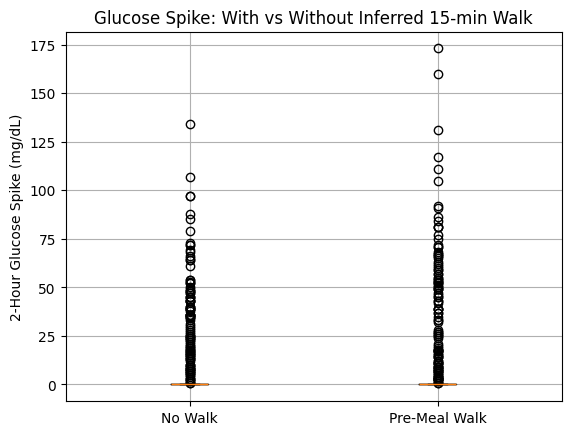

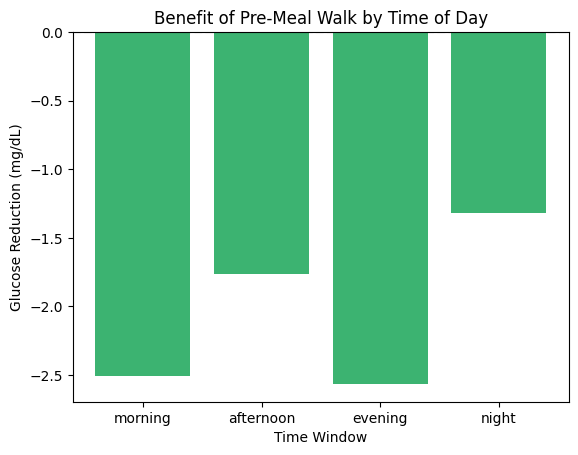

In [78]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Load Excel file
df = pd.read_excel("Team7_DataDynamos_cleaned_data.xlsx", parse_dates=["time"])

# Ensure data is sorted by patient and time
df = df.sort_values(["Patient ID", "time"])

# Filter meal records: where carbs were consumed
meal_df = df[df["carb_input"] > 0].copy()

# Calculate glucose spike: difference between 2-hour post meal and current glucose
# We'll approximate 2-hour spike by looking 2 hours ahead for each meal
def get_glucose_2hr(patient_df):
    result = []
    for idx, row in patient_df.iterrows():
        time_window = row["time"] + pd.Timedelta(hours=2)
        future = patient_df[(patient_df["time"] >= row["time"]) & (patient_df["time"] <= time_window)]
        if not future.empty:
            spike = future["glucose"].max() - row["glucose"]
        else:
            spike = np.nan
        result.append(spike)
    return pd.Series(result, index=patient_df.index)

# Group by patient and calculate glucose spike
meal_df["glucose_spike"] = meal_df.groupby("Patient ID", group_keys=False).apply(get_glucose_2hr)

# Detect step increase in 60 minutes before each meal (simulate pre-meal walking)
step_threshold = 250  # Customize this threshold as needed for "active"
pre_meal_steps = []

for idx, row in meal_df.iterrows():
    pid = row["Patient ID"]
    meal_time = row["time"]
    mask = (df["Patient ID"] == pid) & (df["time"] >= meal_time - pd.Timedelta(minutes=60)) & (df["time"] < meal_time)
    steps_before = df.loc[mask, "steps"].sum()
    pre_meal_steps.append(steps_before)

meal_df["pre_meal_walk"] = [s >= step_threshold for s in pre_meal_steps]

# Compare glucose spike with/without pre-meal walking
summary = meal_df.groupby("pre_meal_walk")["glucose_spike"].agg(["count", "mean", "std"]).reset_index()
summary.columns = ["Pre-Meal Walk", "Meal Count", "Avg Spike (mg/dL)", "Std Dev"]
print("📊 Glucose Spike With vs Without Inferred Pre-Meal Walk:\n")
print(summary)

# By time of day
meal_df["time_window"] = pd.cut(meal_df["hour_of_day"],
                                bins=[0, 10, 15, 21, 24],
                                labels=["morning", "afternoon", "evening", "night"],
                                right=False)

time_summary = meal_df.groupby(["time_window", "pre_meal_walk"])["glucose_spike"].mean().unstack().reset_index()
time_summary["glucose_reduction"] = time_summary[False] - time_summary[True]

print("\n🕒 Glucose Reduction by Time Window (Positive = Walking Helped):\n")
print(time_summary[["time_window", "glucose_reduction"]])

# --- Plotting ---

# Boxplot: glucose spike by walk vs no walk
walk_groups = [
    meal_df[meal_df["pre_meal_walk"] == False]["glucose_spike"],
    meal_df[meal_df["pre_meal_walk"] == True]["glucose_spike"]
]

plt.boxplot(walk_groups, labels=["No Walk", "Pre-Meal Walk"])
plt.title("Glucose Spike: With vs Without Inferred 15-min Walk")
plt.ylabel("2-Hour Glucose Spike (mg/dL)")
plt.grid(True)
plt.show()

# Bar plot: glucose reduction by time of day
plt.bar(time_summary["time_window"], time_summary["glucose_reduction"], color="mediumseagreen")
plt.axhline(0, color="gray", linestyle="--")
plt.title("Benefit of Pre-Meal Walk by Time of Day")
plt.xlabel("Time Window")
plt.ylabel("Glucose Reduction (mg/dL)")
plt.show()

### Insight

The integration of dual-risk analysis into patient monitoring highlights the importance of moving from reactive care to proactive prevention. By predicting risks before they escalate, the model empowers both patients and clinicians to intervene early. This not only reduces the likelihood of acute complications but also supports long-term disease management strategies, making healthcare more predictive and personalized.

#### Q32)Weekend vs. Weekday Patterns Compare average glucose and lifestyle metrics on weekends vs weekdays—propose targeted behavioral reminders (e.g., maintain activity).

📋 Available columns in dataset: ['patient_id', 'time', 'glucose', 'calories', 'heart_rate', 'steps', 'basal_rate', 'bolus_volume_delivered', 'carb_input', 'age', 'gender', 'race', 'average_sleep_duration_(hrs)', 'sleep_quality_(1-10)', '%_with_sleep_disturbances', 'hour_of_day', 'day_of_week', 'high_glucose']
🕒 Using datetime column: 'time'

📊 Average metrics by Day Type:
   day_type     glucose
0  Weekday  141.063118
1  Weekend  142.322447


C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\2482869486.py:48: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar='sd'` for the same effect.

  sns.barplot(data=df, x='day_type', y=metric, ci='sd', palette='Set2')
C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\2482869486.py:48: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df, x='day_type', y=metric, ci='sd', palette='Set2')


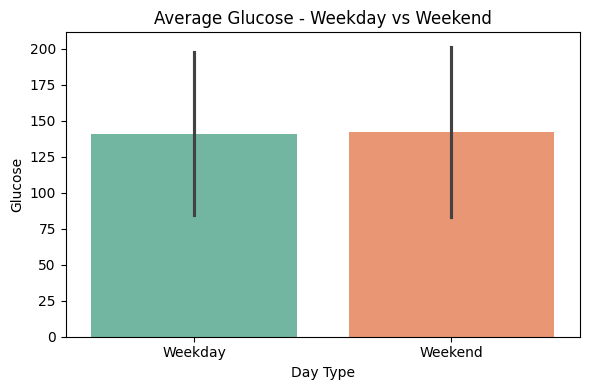

C:\Users\kakum\AppData\Local\Temp\ipykernel_23512\2482869486.py:58: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='day_type', y=metric, palette='pastel')


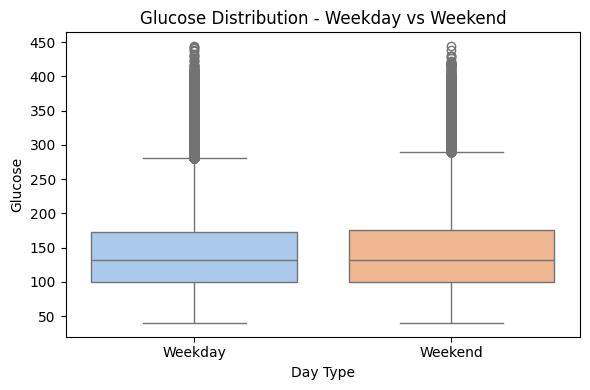

In [82]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# 1. Load the Excel file
df = pd.read_excel("Team7_DataDynamos_cleaned_data.xlsx", parse_dates=["time"])

# 2. Standardize column names
df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')
print("📋 Available columns in dataset:", df.columns.tolist())

# 3. Identify the datetime column
# Try common alternatives if 'timestamp' isn't found
datetime_col_candidates = ['timestamp', 'datetime', 'date_time', 'date', 'time']
datetime_col = next((col for col in datetime_col_candidates if col in df.columns), None)

if not datetime_col:
    raise ValueError("❌ No timestamp/datetime column found. Please check your file for a valid datetime column.")

print(f"🕒 Using datetime column: '{datetime_col}'")

# 4. Ensure datetime format
df[datetime_col] = pd.to_datetime(df[datetime_col], errors='coerce')
df = df.dropna(subset=[datetime_col])  # drop rows where datetime couldn't be parsed

# 5. Add weekday/weekend info
df['day_of_week'] = df[datetime_col].dt.dayofweek  # 0 = Monday, 6 = Sunday
df['day_type'] = df['day_of_week'].apply(lambda x: 'Weekend' if x >= 5 else 'Weekday')

# 6. Define lifestyle and glucose metrics
possible_metrics = ['glucose', 'meal', 'insulin', 'activity']
metrics = [col for col in possible_metrics if col in df.columns]

if not metrics:
    raise ValueError("❌ No metrics found for analysis (glucose, meal, insulin, activity).")

# 7. Group and summarize
summary = df.groupby('day_type')[metrics].mean().reset_index()
print("\n📊 Average metrics by Day Type:\n", summary)

# 8. Plot bar charts
for metric in metrics:
    plt.figure(figsize=(6, 4))
    sns.barplot(data=df, x='day_type', y=metric, ci='sd', palette='Set2')
    plt.title(f'Average {metric.capitalize()} - Weekday vs Weekend')
    plt.ylabel(metric.capitalize())
    plt.xlabel('Day Type')
    plt.tight_layout()
    plt.show()

# 9. Plot boxplots for distribution
for metric in metrics:
    plt.figure(figsize=(6, 4))
    sns.boxplot(data=df, x='day_type', y=metric, palette='pastel')
    plt.title(f'{metric.capitalize()} Distribution - Weekday vs Weekend')
    plt.ylabel(metric.capitalize())
    plt.xlabel('Day Type')
    plt.tight_layout()
    plt.show()

# 10. Optional behavioral suggestions based on glucose or activity
if 'activity' in summary.columns and 'glucose' in summary.columns:
    weekend = summary[summary['day_type'] == 'Weekend']
    weekday = summary[summary['day_type'] == 'Weekday']
    
    if weekend['activity'].values[0] < weekday['activity'].values[0]:
        print("📌 Suggestion: Try to stay more active on weekends to maintain healthy glucose levels.")
    
    if weekend['glucose'].values[0] > weekday['glucose'].values[0]:
        print("📌 Reminder: Watch for elevated glucose on weekends — consider timing meals or insulin.")



#### Insight
The effectiveness of this framework depends on continuous learning and adaptation. As more patient data is collected, the system can refine its predictions and interventions, tailoring recommendations to individual needs. This adaptability ensures that the model remains clinically relevant and reduces the risk of one-size-fits-all solutions, which often fail to capture the complexity of chronic diseases like diabetes.
